# World Data League 2023

## 🎯 Challenge
* Energy communities inclusive of residents vulnerable to energy poverty

## Team: Insight Squad
## 👥 Authors
* Maria Castro
* Ricardo Filipe
* Rodrigo Ferreira
* Catarina Rocha
* Eduardo Vicente

## 💻 Development

##### Imports and Functions and Configuration

In [1]:
datasource_path = 'ghent_data'      # Path of the datasources
flag_run_pandaprofile = False       # Flag to identify if it is to run the panda profile report
flag_save_dataframes = True         # Flag to save dataframe in a file  

In [2]:
%load_ext autotime

import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import geopandas as gpd
import numpy as np
import geopandas as gpd
import pickle
import os
from tqdm.auto import tqdm
from pqdm.processes import pqdm
from pandas_profiling import ProfileReport
from matplotlib import pyplot as plt, dates
import seaborn as sns
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.offline as pyo
from shapely.geometry import Point, Polygon, shape, MultiPolygon, LineString, MultiLineString
from scipy.spatial import distance
from pyproj import CRS, Transformer
import json
from joblib import Parallel, delayed
import multiprocessing as mp
import datetime
import re
import requests
import folium
import branca
import branca.colormap as cm
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import OPTICS


%matplotlib inline

time: 2.35 s (started: 2023-06-21 11:09:20 +00:00)


In [3]:
def enr_date_fields(df, date_field_name, date_format):
    """
    Gets dataframe df that contains a columns with a date and adds to that dataframe the computation of
    date, month, year
        
    Parameters
    ----------
    df : the dataframe that contains the field datetime
    date_field_name: name of the dataframe's field that contains the information of the date
        
    Returns
    -------
    returns a dataframe that is everything the same as the input dataframe, but now enriched with more date-related fields
    """
    
    _df = df.copy()
    _df['date'] = pd.to_datetime(_df[date_field_name], format=date_format)
    _df['month']  = _df['date'].dt.month
    _df['year'] = _df['date'].dt.year
    _df = _df.drop([date_field_name], axis=1)
    
    return _df

time: 606 µs (started: 2023-06-21 11:09:23 +00:00)


In [4]:
def evalCategoricalFields(_df):
    """
    this function serves to give some statistics about the categorical fields of the dataframe  
    
    Parameters
    ----------
    _df : the dataframe that contains the field datetimedate_field_name: name of the dataframe's field that contains the information of the date
        
    Returns
    -------
    returns a dataframe with statistics for all the fields of the dataframe that are categorical
    """
    
    category_stats = []
    for field in _df.dtypes[~((_df.dtypes == "float64") | (_df.dtypes == "int64"))].index:
        vcs = _df[field].value_counts()
        total = vcs.sum()
        entropy = -np.sum((vcs/total)*np.log((vcs/total)))
        category_stats.append([field, len(vcs), _df[field].isna().sum(), entropy])
    category_stats = pd.DataFrame(category_stats, columns=["field", "uniques", "nulls", "entropy"])
    
    return category_stats

time: 4.61 ms (started: 2023-06-21 11:09:23 +00:00)


In [5]:
def evalNumericFields(_df):
    """
    This function serves to give some statistics about the numeric fields of the dataframe  
    
    Parameters
    ----------
    _df : the dataframe that contains the field datetimedate_field_name: name of the dataframe's field that contains the information of the date
        
    Returns
    -------
    returns a dataframe with statistics for all the fields of the dataframe that are numerical
    """
    
    numeric_fields = list(_df.dtypes[_df.dtypes.apply(lambda x: pd.api.types.is_numeric_dtype(x))].index)
    numeric_stats = []
    for field in numeric_fields:
        std_dev = _df[field].std()
        mean = _df[field].mean()
        minimun = _df[field].min()
        maximun = _df[field].max()
        vcs = _df[field].value_counts()
        p = vcs/vcs.sum()
        entropy = -np.sum(p*np.log(p))
        numeric_stats.append([field, mean, minimun, maximun, std_dev, _df[field].nunique(), _df[field].isna().sum(), round(_df[field].isna().sum()/_df[field].count()*100,0) ,entropy])

    numeric_stats = pd.DataFrame(numeric_stats, columns=["field", "mean","min","max","stddev", "uniques", "nulls", "null_perc", "entropy"])
    return numeric_stats

time: 5.94 ms (started: 2023-06-21 11:09:23 +00:00)


In [6]:
def set_correct_datatype(df, col_list, astype):
    
    _df = df.copy()
    if astype == 'int64':
        for col in col_list: 
            _df[col] = _df[col].astype('int64')
            
    if astype == 'float':
        for col in col_list:
            _df[col] = pd.to_numeric(_df[col], errors='coerce').astype('float')
            
    if astype == 'str':
        for col in col_list: 
            _df[col] = _df[col].astype('str')
            
    if astype == 'category':
        for col in col_list: 
            _df[col] = _df[col].astype('category')
        
    return _df

time: 6.8 ms (started: 2023-06-21 11:09:23 +00:00)


In [7]:
def get_info_location_geo_coord(location_list, geocoder_api_key):
    """
    We use this function as a way to get the coordinates of the sectors and streets. 
    But in the meantime we got an external dataset with the sector locations 
    and the WDL provided a dataset with the street information.
    In this function we use an API of OpenCage Geocoder
    
    Parameters
    ----------
    location_list : a list with the name of each location that we want to translate in (lat, lng)
        
    Returns
    -------
    returns a dataframe with 3 columns: city, lat, lon
    """

    # Set y OpthenCage Geocoder API key
    API_KEY = geocoder_api_key
    
    # Dataframe for the results
    _df = pd.DataFrame(columns=['city', 'lat', 'lng'])
    
    for location in location_list:

        city = location
        
        # URL of API do OpenCage Geocoder
        url = f'https://api.opencagedata.com/geocode/v1/json?q={city},%20Ghent,%20Belgium&key={API_KEY}'
        response = requests.get(url)

        # Checking if the request was successful
        if response.status_code == 200:
            data = response.json()

            # Checking for results
            if 'results' in data and len(data['results']) > 0:
                # Getting the coordinates of the first match
                latitude = data['results'][0]['geometry']['lat']
                longitude = data['results'][0]['geometry']['lng']
              
                # Add to df results
                _df = _df.append({'city': city, 'lat': latitude, 'lng': longitude}, ignore_index=True)

                # Imprimindo as coordenadas
                print(f'The coordinates for {city} are: Latitude {latitude}, Longitude {longitude}')
            else:
                print(f'No results found for {city}')
        else:
            print('An error occurred when making the request to the API')
            
    return _df

time: 2.73 ms (started: 2023-06-21 11:09:23 +00:00)


In [8]:
# Função para converter as coordenadas de um polígono do sistema 31370 em 4326
def convert_coordinates(geometry):
    """
    Function to convert the coordinates of a polygon from the EPSG:31370 system into 4326 - WGS84 (lat/lon)
    
    Parameters
    ----------
    geometry : geometry object in EPSG:31370 form
        
    Returns
    -------
    geometry : geometry object in 4326 - WGS84 (lat/lon) form
    """
    
    original_crs = CRS.from_epsg(31370)
    destination_crs = CRS.from_epsg(4326)


    transformer = Transformer.from_crs(original_crs, destination_crs, always_xy=True)
      
    if isinstance(geometry, Polygon):
        # Unique polygon
        coords = list(geometry.exterior.coords)
        transformed_coords = [transformer.transform(x, y)[0:2] for x, y, _ in coords]
        transformed_geometry = Polygon(transformed_coords)
    elif isinstance(geometry, MultiPolygon):
        # MultiPolygon
        polygons = []
        for polygon in geometry.geoms:
            coords = list(polygon.exterior.coords)
            transformed_coords = [transformer.transform(x, y)[0:2] for x, y, _ in coords]
            transformed_polygon = Polygon(transformed_coords)
            polygons.append(transformed_polygon)
        transformed_geometry = MultiPolygon(polygons)
    else:
        transformed_geometry = None

    return transformed_geometry

time: 1.35 ms (started: 2023-06-21 11:09:23 +00:00)


In [9]:
#SLP profiles in Gent:
#* Verbruiksprofielen Elektriciteit
#    * S11 - consumption profile for __professional__ customers with a connection capacity < 56 kVA.
#    * S12 - consumption profile for __professional__ customers with a connection capacity > 56 kVA.
#    * S21 - consumption profile of a __domestic__ consumer with a night-to-day ratio < 1.3 and is also assigned to all those with a single meter as the day-to-night ratio cannot be specified here.
#    * S22 - consumption profile of a __domestic__ consumer with a night-to-day ratio >= 1.3. People with accumulation heating (with exclusive night meter) are usually taken within this profile.
    
#    * S10 - (we assume that this profile is __non-household__ consumer)
    
#* Verbruiksprofielen Aardgas
#    * S41 - consumption profile of a __domestic__ natural gas customer.
#    * S31 - consumption profile of a __professional__ natural gas customer with consumption <150,000 kWh.
#    * S32 - consumption profile of a __professional__ natural gas customer with consumption >=150,000 kWh.
    
#    * S30 - (we assume that this profile is a __professional__ consumer
#    * R21 - (we assume that this profile is a __domestic__ consumer

def categorize_SLP(value):
    """
    Function that translate the SLP profiles in Gent in a label that says professional or domestic
    
    Parameters
    ----------
    value : SLP profile value
        
    Returns
    -------
    return one of the two following labels: professional or domestic
    """
    
    if value in ['S10','S11', 'S12', 'S31', 'S32','S30', 'R11']:
        return 'professional'
    elif value in ['S21', 'S22','S41','R21','R22']:
        return 'domestic'
    else:
        return None
    
def enr_consumer_profile(df, col_slp='SLP'):
    _df = df.copy()
    _df['consumer_profile'] = _df[col_slp].apply(categorize_SLP) 
    
    return _df

time: 10.7 ms (started: 2023-06-21 11:09:23 +00:00)


### EDA
For each datasource we will read it, make an assessment using panda profile report runned over the original datasets.

The WDL provides the following data:
* average_income_per_sector.csv
* energy_consumption_sectors.csv
* energy_decentral_production.csv
* energy_storage_systems.csv
* energy_consumption_monthly.csv
* energy_consumption_street_level.csv
* energy_local_production.csv
* ev_points.csv
* Gent_SLO.shp
* straten-gent.geojson

We also got an extra source of information that gave us information on the various sectors of Ghent. Population, area, coordinate your polygon on the map [1] and [2]:
* sh_statbel_statistical_sectors_31370_20220101.shp
* WDL_sectors_info_external.xlsx


#### Dataset: sector_info_extra

External dataset with some information about each Ghent's Sector:
 - Info about each sector - External Info (see References [1] and [2])

In [10]:
# Info about each sector - External Info (see References [1] and [2]) 
df_poligonos = gpd.read_file('extra/sh_statbel_statistical_sectors_31370_20220101.shp')
df_ghent_poligonos = df_poligonos[df_poligonos['CNIS5_2022']=='44021'][['CS01012022','T_SEC_DE','T_NIS6_NL','M_AREA_HA','M_PERI_M','Shape_Leng','Shape_Area','geometry']]
df_ghent_poligonos.head()
# Aplica a função de conversão de coordenadas a cada polígono no GeoDataFrame
df_ghent_poligonos['geometry_'] = df_ghent_poligonos['geometry'].apply(convert_coordinates)
df_ghent_poligonos.head()

df_sector_info_extra = pd.read_excel('extra/WDL_sectors_info_external.xlsx')
df_sector_info_extra = df_sector_info_extra.merge(df_ghent_poligonos[['CS01012022','T_SEC_DE','T_NIS6_NL','M_AREA_HA','M_PERI_M','Shape_Leng','Shape_Area','geometry','geometry_']], on='T_SEC_DE')
df_sector_info_extra.head(3)

,sector_WDL,T_SEC_DE,sector_external_source,sector_code,postcode,0-19,20-64,65+,population,area_km2,...,lon,googlemaps_link,CS01012022,T_NIS6_NL,M_AREA_HA,M_PERI_M,Shape_Leng,Shape_Area,geometry,geometry_
0,Aaigem,AAIGEM,Aaigem,B354,9000,268,1029,273,1570,0.9415,...,3.702773,https://www.google.com/maps/@51.03303515933687...,44021B354,GENT ZUID,94.143863,4666.0,4666.080273,9.414536e+05,"POLYGON Z ((102541.812 192327.543 0.000, 10259...","POLYGON ((3.692 51.039, 3.693 51.039, 3.693 51..."
1,NaN,ACHTENDRIES,Achtendries,E222,9000,342,913,239,1494,1.2380,...,3.794294,https://www.google.com/maps/@51.07692484922749...,44021E222,SINT-AMANDSBERG,123.751650,4627.0,4627.215161,1.237536e+06,"POLYGON Z ((110595.959 195933.094 0.000, 11058...","POLYGON ((3.807 51.072, 3.806 51.072, 3.806 51..."
2,Afrikalaan,AFRIKALAAN,Afrikalaan,C710,9000,254,777,84,1115,0.6484,...,3.737606,"https://www.google.com/maps/@51.0704347545529,...",44021C710,GENT MUIDE-SIFFERDOK,64.841976,4114.0,4114.046846,6.484301e+05,"POLYGON Z ((105972.102 194471.121 0.000, 10596...","POLYGON ((3.741 51.059, 3.741 51.058, 3.740 51..."


time: 28.3 s (started: 2023-06-21 11:09:23 +00:00)


In [11]:
df_sector_info_total = df_sector_info_extra.copy()

time: 998 µs (started: 2023-06-21 11:09:51 +00:00)


#### List of all sources provide by WDL

In [12]:
# list all files in the datasources
all_files = [os.path.join(root, file) for root, dirs, files in os.walk(datasource_path) for file in sorted(files)]
print('List of all files made available for this challenge:')
all_files

List of all files made available for this challenge:


['ghent_data/.DS_Store',
 'ghent_data/average_income_per_sector.csv',
 'ghent_data/energy_consumption_monthly.csv',
 'ghent_data/energy_consumption_sectors.csv',
 'ghent_data/energy_consumption_street_level.csv',
 'ghent_data/energy_decentral_production.csv',
 'ghent_data/energy_local_production.csv',
 'ghent_data/energy_storage_systems.csv',
 'ghent_data/ev_points.csv',
 'ghent_data/ghent_data.zip',
 'ghent_data/straten-gent.dbf',
 'ghent_data/straten-gent.geojson',
 'ghent_data/straten-gent.prj',
 'ghent_data/straten-gent.shp',
 'ghent_data/straten-gent.shx',
 'ghent_data/straten-gent.zip',
 'ghent_data/pv_data/Gent_SLO.dbf',
 'ghent_data/pv_data/Gent_SLO.shp',
 'ghent_data/pv_data/Gent_SLO.shx',
 'ghent_data/pv_data/Gent_SLO_Max.dbf',
 'ghent_data/pv_data/Gent_SLO_Max.shp',
 'ghent_data/pv_data/Gent_SLO_Max.shx',
 'ghent_data/pv_data/Gent_SOL.prj',
 'ghent_data/pv_data/Gent_SOL_Max.dbf',
 'ghent_data/pv_data/Gent_SOL_Max.shp',
 'ghent_data/pv_data/Gent_SOL_Max.shx',
 'ghent_data/pv_

time: 8.3 ms (started: 2023-06-21 11:09:51 +00:00)


#### Dataset: average_income_per_sector

##### Read datasource & enrich/clean

Here we read the datasource and create the following dataframes:
* df_average_income_per_sector:
    * sector - indetification of the Ghent's sector (Location)
    * 2005 - average income per person in 2005
    ...
    * 2019 - average income per person in 2019
* df_average_income_per_sector_t:
    * sector - indetification of the Ghent's sector (Location)
    * year - identification of the civil year
    * avg_income_value - average income per person in a year
    

In [13]:
#Read the dataset and rename the columns to the respective year
df_average_income_per_sector = pd.read_csv('ghent_data/average_income_per_sector.csv', sep=';', header=0)
df_average_income_per_sector.columns = ['sector'] + [str(year) for year in range(2005,2020, 1)]
df_average_income_per_sector

,sector,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,'T Schaarken,15798,16102,17171,17313,18719,17738,18672,19719,19584,20195,19385,19396,21034,21301,21528
1,Aaigem,20026,20716,21215,22769,22293,22840,24048,24689,25266,26007,25060,26309,27145,27914,26573
2,Afrikalaan,9698,9994,10104,10547,10444,10177,10162,10891,10658,10813,10633,10452,11194,11913,12551
3,Afsnee - Centrum,18571,20131,20216,21892,22118,22991,21650,23754,25673,24109,28997,26759,25726,31444,32092
4,Akademisch Ziekenhuis,4264,5466,8376,20458,12582,11311,11200,10287,13062,17362,19001,21153,20214,20404,23023
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162,Zonneput,14629,14742,15224,20933,18281,17717,17935,19398,20170,22110,20908,21723,21699,21923,22594
163,Zuidpark,18903,19496,19631,17399,22334,21857,22232,23319,23193,23353,23093,23118,23298,23664,23952
164,Zwarte Fles,x,x,x,15945,16757,17453,18632,19167,x,x,x,x,x,x,x
165,Zwijnaarde - Centrum,15747,16320,17056,17566,19296,18259,18621,19296,19636,20329,20027,21158,21942,21583,22710


time: 38.6 ms (started: 2023-06-21 11:09:51 +00:00)


In [14]:
# The PandaProfile Report  indicated:
# - For each column between 2005 and 2019, we have at most 1 value missing and some values with the value 'x', that is an invalid value
#   - we will standardise these missing values and transform the columns into numeric data

for col in [str(year) for year in range(2005,2020, 1)]:
    df_average_income_per_sector[col] = df_average_income_per_sector[col].replace('x', np.nan)
    
df_average_income_per_sector = set_correct_datatype(df_average_income_per_sector, [str(year) for year in range(2005,2020, 1)], 'float')

time: 23.3 ms (started: 2023-06-21 11:09:51 +00:00)


In [15]:
df_average_income_per_sector

,sector,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,'T Schaarken,15798.0,16102.0,17171.0,17313.0,18719.0,17738.0,18672.0,19719.0,19584.0,20195.0,19385.0,19396.0,21034.0,21301.0,21528.0
1,Aaigem,20026.0,20716.0,21215.0,22769.0,22293.0,22840.0,24048.0,24689.0,25266.0,26007.0,25060.0,26309.0,27145.0,27914.0,26573.0
2,Afrikalaan,9698.0,9994.0,10104.0,10547.0,10444.0,10177.0,10162.0,10891.0,10658.0,10813.0,10633.0,10452.0,11194.0,11913.0,12551.0
3,Afsnee - Centrum,18571.0,20131.0,20216.0,21892.0,22118.0,22991.0,21650.0,23754.0,25673.0,24109.0,28997.0,26759.0,25726.0,31444.0,32092.0
4,Akademisch Ziekenhuis,4264.0,5466.0,8376.0,20458.0,12582.0,11311.0,11200.0,10287.0,13062.0,17362.0,19001.0,21153.0,20214.0,20404.0,23023.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162,Zonneput,14629.0,14742.0,15224.0,20933.0,18281.0,17717.0,17935.0,19398.0,20170.0,22110.0,20908.0,21723.0,21699.0,21923.0,22594.0
163,Zuidpark,18903.0,19496.0,19631.0,17399.0,22334.0,21857.0,22232.0,23319.0,23193.0,23353.0,23093.0,23118.0,23298.0,23664.0,23952.0
164,Zwarte Fles,NaN,NaN,NaN,15945.0,16757.0,17453.0,18632.0,19167.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
165,Zwijnaarde - Centrum,15747.0,16320.0,17056.0,17566.0,19296.0,18259.0,18621.0,19296.0,19636.0,20329.0,20027.0,21158.0,21942.0,21583.0,22710.0


time: 26.4 ms (started: 2023-06-21 11:09:51 +00:00)


In [16]:
# Creat a transpose of the dataframe with the columns sector, year and value
df_average_income_per_sector_t = pd.melt(df_average_income_per_sector, id_vars='sector', var_name='year', value_name='avg_income_value')
df_average_income_per_sector_t = df_average_income_per_sector_t.dropna(subset=['avg_income_value'])  
df_average_income_per_sector_t = set_correct_datatype(df_average_income_per_sector_t, ['avg_income_value'], 'int64')
df_average_income_per_sector_t

,sector,year,avg_income_value
0,'T Schaarken,2005,15798
1,Aaigem,2005,20026
2,Afrikalaan,2005,9698
3,Afsnee - Centrum,2005,18571
4,Akademisch Ziekenhuis,2005,4264
...,...,...,...
2499,Wondelgemstraat,2019,11358
2500,Zonneput,2019,22594
2501,Zuidpark,2019,23952
2503,Zwijnaarde - Centrum,2019,22710


time: 17.7 ms (started: 2023-06-21 11:09:51 +00:00)


#### Dataset: energy_consumption_monthly

In [17]:
df_energy_consumption_monthly = pd.read_csv('ghent_data/energy_consumption_monthly.csv', sep=';', header=0)
df_energy_consumption_monthly.drop('Regio', axis=1, inplace=True)
df_energy_consumption_monthly.rename(columns={'Hoofdgemeente': 'municipality',
                                               'Energie': 'energy'}, inplace=True)
df_energy_consumption_monthly.head()

,municipality,energy,SLP,202109,202108,202107,202106,202105,202104,202103,202102,202101,202012,202011,202010,202009
0,AALST,Aardgas,S30,6809886.41,7902539.58,6456549.50,6635968.17,9231681.62,9205370.95,9744194.29,9088327.04,10260022.55,8634327.69,9573311.13,7993325.38,7109659.32
1,AALST,Aardgas,S32,5683473.77,5182523.50,4606805.44,4875152.01,10715286.02,15690223.17,19771732.09,21622234.87,26822992.43,22680563.74,15995598.85,12422085.73,5850694.92
2,AALST,Aardgas,S41,9662256.11,7017670.36,5873547.05,6748630.97,23947030.29,41479068.34,50465756.37,58257203.97,78000842.42,63883298.02,40926293.27,28231750.34,10953250.20
3,AALST,Elektriciteit,S10,14509321.32,13598049.30,12996783.41,14804512.98,13046598.45,13361543.28,14415915.86,13631701.64,14801234.59,13273329.23,13379081.53,14733295.96,13970571.32
4,AALTER,Aardgas,S41,2155763.89,1561970.56,1292835.82,1488390.88,5312705.99,9210432.99,11225292.25,12939253.62,17334380.22,14213972.29,9104483.01,6271174.44,2420428.67


time: 25.2 ms (started: 2023-06-21 11:09:51 +00:00)


In [18]:
# Creat a transpose of the dataframe with the columns sector, year and value
df_energy_consumption_monthly_t = pd.melt(df_energy_consumption_monthly, id_vars=['municipality', 'energy','SLP'], var_name='year_month', value_name='energy_consumption')
df_energy_consumption_monthly_t = df_energy_consumption_monthly_t.dropna(subset=['energy_consumption'])  
df_energy_consumption_monthly_t.head(3)

,municipality,energy,SLP,year_month,energy_consumption
0,AALST,Aardgas,S30,202109,6809886.41
1,AALST,Aardgas,S32,202109,5683473.77
2,AALST,Aardgas,S41,202109,9662256.11


time: 18.6 ms (started: 2023-06-21 11:09:51 +00:00)


In [19]:
# Trasnform the year_month field in a data format
df_energy_consumption_monthly_t = enr_date_fields(df=df_energy_consumption_monthly_t, date_field_name='year_month', date_format="%Y%m")
df_energy_consumption_monthly_t.head(3)

,municipality,energy,SLP,energy_consumption,date,month,year
0,AALST,Aardgas,S30,6809886.41,2021-09-01,9,2021
1,AALST,Aardgas,S32,5683473.77,2021-09-01,9,2021
2,AALST,Aardgas,S41,9662256.11,2021-09-01,9,2021


time: 37.5 ms (started: 2023-06-21 11:09:51 +00:00)


#### Dataset: energy_consumption_sectors

In [20]:
# some cheat sheets
# Column Verbruiksjaar > Year
# Column Markt > Energie
# Column Richting: Afname = Offtake, Injectie = Injection
# Column Rol Contact: Persoon = person, Bedrijf = company

df_energy_consumption_sectors = pd.read_csv('ghent_data/energy_consumption_sectors.csv', sep=';', header=0)
df_energy_consumption_sectors.rename(columns={'Verbruiksjaar': 'year',
                                               'Markt': 'energy',
                                               'Richting': 'direction',
                                               'Provincie': 'province',
                                               'Gemeente': 'municipality',
                                               'Subsector': 'subsector',
                                               'Sector': 'sector',
                                               'Statistische Sector': 'statistical_sector',
                                               'Rol Contact': 'contact_role',
                                               'Aantal': 'number_access_points',
                                               'Benaderend Verbruik (kWh)': 'approximate_consumption_kWh'}, inplace=True)
df_energy_consumption_sectors.head()


,year,energy,direction,statistical_sector,province,municipality,subsector,sector,contact_role,number_access_points,approximate_consumption_kWh
0,2018,Elektriciteit,Afname,12030D012,ANTWERPEN,PUURS,Huishoudelijk,Huishoudens,Persoon,62.0,372775.11370
1,2018,Elektriciteit,Afname,12030D063,ANTWERPEN,PUURS,Huishoudelijk,Huishoudens,Persoon,10.0,33802.70198
2,2018,Elektriciteit,Afname,12030D080,ANTWERPEN,PUURS,"Andere gemeenschaps-, sociale en persoonlijke ...",Tertiaire sector,Bedrijf,4.0,60453.87370
3,2018,Elektriciteit,Afname,12030D080,ANTWERPEN,PUURS,Rest,Industrie,Bedrijf,3.0,13458.41425
4,2018,Elektriciteit,Afname,12030D091,ANTWERPEN,PUURS,Kantoren en administraties,Tertiaire sector,Bedrijf,16.0,127926.47500


time: 656 ms (started: 2023-06-21 11:09:51 +00:00)


In [21]:
df_energy_consumption_sectors['sector'].unique()

array(['Huishoudens', 'Tertiaire sector', 'Industrie', 'Rest',
       'Empty/onbekend', 'Landbouw, bosbouw en visserij', 'Transport',
       'Energiesector', 'Openbare verlichting'], dtype=object)

time: 35.6 ms (started: 2023-06-21 11:09:52 +00:00)


#### Dataset: energy_consumption_street_level

In [22]:
df_energy_consumption_street_level = pd.read_csv('ghent_data/energy_consumption_street_level.csv', sep=';', header=0)

df_energy_consumption_street_level.rename(columns={'Verbruiksjaar': 'year',
                                               'Hoofdgemeente': 'municipality',
                                               'Energie': 'energy',
                                               'Richting': 'direction',
                                               'Straat': 'street',
                                               'Aantal Toegangspunten': 'number_access_points',
                                               'Benaderend verbruik (kWh)': 'approximate_consumption_kWh'}, inplace=True)

# According to the data dictionary: the column 'Regio' is a region, and a region consists of several main municipalities.
# This subdivision into Region 1 and Region 2 is only included in the datasets with data up to and including the end of 2017. This is because the two former energy companies in Flanders (Infrax and Eandis) 
# used a different calculation method to determine the approximate consumption.
# The same calculation method is used for the data from 1/1/2018, and the region is therefore no longer relevant. From then on, all municipalities will fall under Region 1.
# - For this use case we will only use the data from 2018 to 2021 where only Regio 1 exists 
df_energy_consumption_street_level = df_energy_consumption_street_level[df_energy_consumption_street_level['year'] >= 2018]
df_energy_consumption_street_level.drop('Regio', axis=1, inplace=True)
df_energy_consumption_street_level.head()

# Missing values:
# street - 2 in 559610 lines
# approximate_consumption_kWh - 114 in 559610 lines

,year,municipality,energy,direction,street,number_access_points,approximate_consumption_kWh
0,2020,WETTEREN,Aardgas,Afname,FORTSTRAAT,77,1047184.61
2,2020,WETTEREN,Aardgas,Afname,GAVERSTRAATJE,3,40422.96
4,2020,WETTEREN,Aardgas,Afname,GENTSESTEENWEG,274,4818675.45
6,2020,WETTEREN,Aardgas,Afname,GEREEDSTRAAT,27,275108.29
8,2020,WETTEREN,Aardgas,Afname,HELVERDINKSTRAAT,16,225078.37


time: 1.64 s (started: 2023-06-21 11:09:52 +00:00)


#### Dataset: energy_decentral_production

In [23]:
# Type technologie - Type of production technology: 
#    'Zonne-Energie (PV)' = Solar, 'Windenergie' = Wind, 'Andere' = Others, 'WKK Aardgas' = Natural Gas,
#    'Brandstofcel' = Fuel cell, 'WKK Biomassa/Biogas' = Biomass/Biogas
# Spanningsniveau aansluiting: LS (low voltage), MS (medium voltage)

df_energy_decentral_production = pd.read_csv('ghent_data/energy_decentral_production.csv', sep=';', header=0)
df_energy_decentral_production.drop('Uniek_order_ID', axis=1, inplace=True)
df_energy_decentral_production.drop('Postcode (hiërarchisch)', axis=1, inplace=True)

df_energy_decentral_production.rename(columns={'Jaartal indienstname': 'year',
                                               'Type technologie': 'type_technology',
                                               'Vermogen (kVA)': 'max_power_capacity_kVA',
                                               'Spanningsniveau aansluiting': 'voltage_level_connection',
                                               'Gemeente Nis Code': 'municipality_code',
                                               'Postcode': 'postcode'}, inplace=True)

df_energy_decentral_production.head()


# Missing Values:
# voltage_level_connection has  missing values in the all dataset
# year has 


,year,type_technology,max_power_capacity_kVA,voltage_level_connection,municipality_code,postcode
0,2015.0,Zonne-Energie (PV),2.500,LS,38014.0,8670.0
1,2017.0,Zonne-Energie (PV),3.096,LS,38014.0,8670.0
2,2017.0,Zonne-Energie (PV),5.000,LS,38014.0,8670.0
3,2016.0,Zonne-Energie (PV),2.200,LS,38014.0,8670.0
4,2017.0,Zonne-Energie (PV),6.000,LS,38014.0,8670.0


time: 498 ms (started: 2023-06-21 11:09:54 +00:00)


#### Dataset: energy_local_production
- DNB - Distribution system operator
- Main municipality. (Niet toegewezen = Unassigned)

In [24]:
df_energy_local_production = pd.read_csv('ghent_data/energy_local_production.csv', sep=';', header=0)

df_energy_local_production.rename(columns={'Peildatum': 'year_month',
                                               'DNB': 'DNB',
                                               'HOOFDGEMEENTE': 'municipality',
                                               'Technologie': 'technology',
                                               'Aantal installaties': 'access_points_installations',
                                               'Geïnstalleerd vermogen (kVA)': 'installed_power_kVA'}, inplace=True)

df_energy_local_production.head()

,year_month,DNB,municipality,technology,access_points_installations,installed_power_kVA
0,2022-10,Niet toegewezen,Niet toegewezen,ZONNE-ENERGIE,25,2420.60
1,2022-10,FLUVIUS ANTWERPEN,AARTSELAAR,ZONNE-ENERGIE,1401,9294.76
2,2022-10,FLUVIUS ANTWERPEN,ANTWERPEN,BIOMASSA (GEEN WKK),6,20469.00
3,2022-10,FLUVIUS ANTWERPEN,ANTWERPEN,BRANDSTOFCEL,8,30.75
4,2022-10,FLUVIUS ANTWERPEN,ANTWERPEN,DIESEL (GEEN WKK),7,9020.00


time: 10.6 ms (started: 2023-06-21 11:09:54 +00:00)


#### Dataset: energy_storage_systems

In [25]:
df_energy_storage_systems = pd.read_csv('ghent_data/energy_storage_systems.csv', sep=';', header=0)
df_energy_storage_systems.rename(columns={'Maand in dienst': 'year_month',
                                          'Jaartal indienstname': 'year',
                                          'Maand indienstname': 'month',
                                          'Type technologie': 'type_technology', #only Thuisbatterij = Home battery
                                          'Capaciteit (kWh)': 'storage_capacity_kWh',
                                          'Vermogen omvormer (kVA)': 'inverter_power_kVA',
                                          'LS/MS':'voltage_level_connection' }, inplace=True)
df_energy_storage_systems.drop('Uniek_order_ID', axis=1, inplace=True)
df_energy_storage_systems.head()

,year_month,year,month,type_technology,storage_capacity_kWh,inverter_power_kVA,voltage_level_connection
0,2022-10,2022.0,10.0,Thuisbatterij,4.56,3.0,LS
1,2022-10,2022.0,10.0,Thuisbatterij,10.00,5.0,LS
2,2022-10,2022.0,10.0,Thuisbatterij,4.40,4.0,LS
3,2022-10,2022.0,10.0,Thuisbatterij,5.70,4.6,LS
4,2022-10,2022.0,10.0,Thuisbatterij,10.12,5.0,LS


time: 35.2 ms (started: 2023-06-21 11:09:54 +00:00)


#### Dataset: ev_points

In [26]:
df_ev_points = pd.read_csv('ghent_data/ev_points.csv', sep=';', header=0)
df_ev_points.rename(columns={'Jaartal indienstname': 'year',
                             'Postcode': 'postcode',
                             'Vermogen (kVA)': 'max_power_capacity_kVA',
                             'Spanningsniveau aansluiting': 'voltage_level_connection'}, inplace=True)
df_ev_points.drop('Uniek_order_ID', axis=1, inplace=True)
df_ev_points.drop('Postcode (hiërarchisch)', axis=1, inplace=True)
df_ev_points.drop('Postcode Numeriek', axis=1, inplace=True)
df_ev_points.head()

,year,postcode,max_power_capacity_kVA,voltage_level_connection,geom,centroid
0,2017,3840,22.2,LS,"{""coordinates"": [[[[5.372256859, 50.842703966]...","50.804781683,5.340930556"
1,2017,3700,22.2,LS,"{""coordinates"": [[[[5.416280501, 50.722817984]...","50.771788367,5.464431132"
2,2017,8600,22.2,LS,"{""coordinates"": [[[[2.770542675, 51.017105977]...","51.047386295,2.854235412"
3,2017,3770,22.2,LS,"{""coordinates"": [[[[5.614790217, 50.838689041]...","50.805367608,5.592306546"
4,2017,8820,22.2,LS,"{""coordinates"": [[[[3.043475238, 51.060621091]...","51.062335749,3.095486083"


time: 141 ms (started: 2023-06-21 11:09:54 +00:00)


In [27]:
# select the postcode that correspond to Gent and then see how many ev_points we have
df_ev_points[df_ev_points['postcode'].isin(df_sector_info_total['postcode'])][['centroid']].drop_duplicates()

# the centroid reports in terms of a big area and not the exact place :(
# several ev points are pointing to the save coordinates point

,centroid
78,"51.074456842,3.7255309739999998"
126,"51.103088554,3.857113533"
916,"51.143314913,3.70818594"


time: 9.37 ms (started: 2023-06-21 11:09:54 +00:00)


#### Dataset: Gent_SOL

In [28]:
df_gent_SOL = gpd.read_file('ghent_data/pv_data/Gent_SOL_v3.shp')
df_gent_SOL.rename(columns={'GRB_UIDN': 'build_id',
                        'GRB_OIDN': 'build_obj_id',
                        'ENTITEIT': 'build_type',
                        'TYPE': 'build_type_id',
                        'LBLTYPE': 'build_category',
                        'DATUM_GRB': 'date_geo',
                        'DATUM_LID': 'date_map',
                        'OPPERVL': 'build_surface_area_m2',
                        'LENGTE': 'build_length_m',
                        'STRAATNMID': 'street_id',
                        'STRAATNM': 'street_name',
                        'NISCODE': 'NIS_code',
                        'GEMEENTE': 'municipality',
                        'POSTCODE': 'postcode',
                        'HNRLABEL': 'build_number',
                        'SOL_OPP': 'sol_opportunity_area',
                        'SOL_OPP_3D': 'sol_opportunity_area_3D',
                        'SLOPE': 'slope',
                        'ASPECT': 'roof_direction',
                        'Type_Dak': 'roof_type',
                        'Opwek_E': 'electricity_potencial_prod_kWh'}, inplace=True)
df_gent_SOL.head()


,build_id,build_obj_id,build_type,build_type_id,build_category,date_geo,date_map,build_surface_area_m2,build_length_m,street_id,...,build_number,sol_opportunity_area,sol_opportunity_area_3D,slope,roof_direction,IRR_SqM,IRR_Tot,roof_type,electricity_potencial_prod_kWh,geometry
0,149248,109594,Gbg,1,hoofdgebouw,2003-10-16,2013-04-08,296.97,107.28,69676,...,5-15,72,72,6,252,932,67573,plat,5989,"POLYGON ((103665.500 187983.500, 103665.500 18..."
1,149248,109594,Gbg,1,hoofdgebouw,2003-10-16,2013-04-08,296.97,107.28,69676,...,5-15,140,140,1,-9999,976,137162,plat,12195,"POLYGON ((103650.500 187989.000, 103652.000 18..."
2,156401,116747,Gbg,1,hoofdgebouw,2003-10-16,2013-04-08,385.93,98.09,0,...,NaN,336,336,1,195,1006,339773,plat,30168,"POLYGON ((104249.000 187569.500, 104249.000 18..."
3,140442,100788,Gbg,1,hoofdgebouw,2003-10-16,2013-04-08,121.68,59.73,70254,...,23,8,8,10,138,893,8040,plat,638,"POLYGON ((102316.500 187871.000, 102316.500 18..."
4,140442,100788,Gbg,1,hoofdgebouw,2003-10-16,2013-04-08,121.68,59.73,70254,...,23,22,27,36,130,995,22639,hellend,3425,"POLYGON ((102314.000 187868.500, 102313.693 18..."


time: 1min 29s (started: 2023-06-21 11:09:54 +00:00)


In [29]:
df_gent_SOL[df_gent_SOL['NIS_code']=='44021']['postcode'].unique()

array([9052, 9050, 9000, 9051, 9030, 9032, 9040, 9041, 9042, 9031])

time: 138 ms (started: 2023-06-21 11:11:24 +00:00)


##### Enrich the Gent_SOL with Gent sector identification

In [30]:
#  Add a column for the sector in the roofs dataframe
df_gent_SOL['sector'] = None

# Iterate on the sector polygons and check the overlap with the roof polygons
for i, setor in df_sector_info_total.iterrows():
    intersected = df_gent_SOL[df_gent_SOL.geometry.intersects(setor.geometry)]
    intersected['sector'] = setor['sector_WDL']
    df_gent_SOL.update(intersected)

# Check the roofs that do not overlap with any sector and assign a default value (optional)
df_gent_SOL['sector'] = df_gent_SOL['sector'].fillna('N/A')
df_gent_SOL.head(3)

,build_id,build_obj_id,build_type,build_type_id,build_category,date_geo,date_map,build_surface_area_m2,build_length_m,street_id,...,sol_opportunity_area,sol_opportunity_area_3D,slope,roof_direction,IRR_SqM,IRR_Tot,roof_type,electricity_potencial_prod_kWh,geometry,sector
0,149248.0,109594.0,Gbg,1.0,hoofdgebouw,2003-10-16,2013-04-08,296.97,107.28,69676.0,...,72.0,72.0,6.0,252.0,932.0,67573.0,plat,5989.0,"POLYGON ((103665.500 187983.500, 103665.500 18...",Zwijnaarde - Centrum
1,149248.0,109594.0,Gbg,1.0,hoofdgebouw,2003-10-16,2013-04-08,296.97,107.28,69676.0,...,140.0,140.0,1.0,-9999.0,976.0,137162.0,plat,12195.0,"POLYGON ((103650.500 187989.000, 103652.000 18...",Ter Linden
2,156401.0,116747.0,Gbg,1.0,hoofdgebouw,2003-10-16,2013-04-08,385.93,98.09,0.0,...,336.0,336.0,1.0,195.0,1006.0,339773.0,plat,30168.0,"POLYGON ((104249.000 187569.500, 104249.000 18...",Zonneput


time: 1min 42s (started: 2023-06-21 11:11:24 +00:00)


#### Dataset: straten-gent

In [31]:
df_straten_gent = gpd.read_file('ghent_data/straten-gent.geojson')
df_straten_gent.head()

,rrcode_l,rrcode_r,crabcode,pcode_l,pcode_r,naam,geo_point_2d,geometry
0,NaN,NaN,NaN,NaN,NaN,NaN,"{'lon': 3.8041402237658897, 'lat': 51.14132180...","LINESTRING (3.80661 51.14068, 3.80643 51.14082..."
1,NaN,NaN,NaN,9000,NaN,NaN,"{'lon': 3.7064809541414867, 'lat': 51.04462657...","LINESTRING (3.70647 51.04467, 3.70649 51.04459)"
2,NaN,NaN,NaN,9000,9000,NaN,"{'lon': 3.6992769552395686, 'lat': 51.06649235...","MULTILINESTRING ((3.69960 51.06623, 3.69959 51..."
3,NaN,NaN,NaN,9000,9000,NaN,"{'lon': 3.717429737612361, 'lat': 51.018142751...","MULTILINESTRING ((3.71819 51.01790, 3.71700 51..."
4,NaN,NaN,NaN,9000,9000,NaN,"{'lon': 3.7188685732383426, 'lat': 51.01834533...","LINESTRING (3.71848 51.01842, 3.71926 51.01827)"


time: 1.56 s (started: 2023-06-21 11:13:07 +00:00)


In [32]:
# Fill in the NaN values with None
df_straten_gent['naam'] = df_straten_gent['naam'].fillna('unknown')
df_straten_gent['naam'] = df_straten_gent['naam'].str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8').str.upper()
df_straten_gent.head()

,rrcode_l,rrcode_r,crabcode,pcode_l,pcode_r,naam,geo_point_2d,geometry
0,NaN,NaN,NaN,NaN,NaN,UNKNOWN,"{'lon': 3.8041402237658897, 'lat': 51.14132180...","LINESTRING (3.80661 51.14068, 3.80643 51.14082..."
1,NaN,NaN,NaN,9000,NaN,UNKNOWN,"{'lon': 3.7064809541414867, 'lat': 51.04462657...","LINESTRING (3.70647 51.04467, 3.70649 51.04459)"
2,NaN,NaN,NaN,9000,9000,UNKNOWN,"{'lon': 3.6992769552395686, 'lat': 51.06649235...","MULTILINESTRING ((3.69960 51.06623, 3.69959 51..."
3,NaN,NaN,NaN,9000,9000,UNKNOWN,"{'lon': 3.717429737612361, 'lat': 51.018142751...","MULTILINESTRING ((3.71819 51.01790, 3.71700 51..."
4,NaN,NaN,NaN,9000,9000,UNKNOWN,"{'lon': 3.7188685732383426, 'lat': 51.01834533...","LINESTRING (3.71848 51.01842, 3.71926 51.01827)"


time: 39.3 ms (started: 2023-06-21 11:13:09 +00:00)


##### Enrich the straten gent dataset with sector identification

In [33]:
# Convert the df_straten_gent_that_match DataFrame to a GeoDataFrame
df_straten_gent_copy = df_straten_gent.copy()
gdf_straten_gent = gpd.GeoDataFrame(df_straten_gent_copy, geometry=gpd.points_from_xy(df_straten_gent_copy['geo_point_2d'].apply(lambda x: x['lon']), df_straten_gent_copy['geo_point_2d'].apply(lambda x: x['lat'])))

# Convert the df_sector_info_total DataFrame to a GeoDataFrame
df_sector_info_total_c = df_sector_info_total.copy()
gdf_sector_info = gpd.GeoDataFrame(df_sector_info_total_c.drop(['geometry'], axis=1), geometry='geometry_')

# Create an empty list to store the selected sector_wdl values
selected_sector_wdl = []

# Iterate over each row in the gdf_straten_gent GeoDataFrame
for _, row in gdf_straten_gent.iterrows():
    point = row['geometry']
    
    # Find the sector_wdl whose geometry contains the point
    mask = gdf_sector_info['geometry_'].contains(point)
    if any(mask):
        sector_wdl = gdf_sector_info.loc[mask, 'T_SEC_DE'].values[0]

    else:
        # Calculate the distances between the point and the polygons of all sectors
        distances = gdf_sector_info['geometry_'].apply(lambda geom: distance.euclidean(point.coords[0], geom.centroid.coords[0]))

        # Find the index of the sector with the minimum distance
        min_distance_idx = distances.idxmin()

        # Retrieve the sector_wdl of the nearest sector
        sector_wdl = gdf_sector_info.loc[min_distance_idx, 'T_SEC_DE'] if len(gdf_sector_info) > 0 else 'N/A'

    
    # Add the sector_wdl to the list
    selected_sector_wdl.append(sector_wdl)
    
# Add the selected_sector_wdl as a new column in the df_straten_gent_that_match DataFrame
df_straten_gent_copy['T_SEC_DE'] = selected_sector_wdl
df_straten_gent_copy['geometry_point_2d'] = df_straten_gent_copy['geometry']
df_straten_gent_copy.drop('geometry', axis=1, inplace=True)
df_straten_gent_copy['geometry'] = df_straten_gent['geometry']
df_straten_gent = df_straten_gent_copy
df_straten_gent.head()

,rrcode_l,rrcode_r,crabcode,pcode_l,pcode_r,naam,geo_point_2d,T_SEC_DE,geometry_point_2d,geometry
0,NaN,NaN,NaN,NaN,NaN,UNKNOWN,"{'lon': 3.8041402237658897, 'lat': 51.14132180...",MENDONK,POINT (3.80414 51.14132),"LINESTRING (3.80661 51.14068, 3.80643 51.14082..."
1,NaN,NaN,NaN,9000,NaN,UNKNOWN,"{'lon': 3.7064809541414867, 'lat': 51.04462657...",NEERMEERSEN,POINT (3.70648 51.04463),"LINESTRING (3.70647 51.04467, 3.70649 51.04459)"
2,NaN,NaN,NaN,9000,9000,UNKNOWN,"{'lon': 3.6992769552395686, 'lat': 51.06649235...",RUSTOORD,POINT (3.69928 51.06649),"MULTILINESTRING ((3.69960 51.06623, 3.69959 51..."
3,NaN,NaN,NaN,9000,9000,UNKNOWN,"{'lon': 3.717429737612361, 'lat': 51.018142751...",NIEUW GENT,POINT (3.71743 51.01814),"MULTILINESTRING ((3.71819 51.01790, 3.71700 51..."
4,NaN,NaN,NaN,9000,9000,UNKNOWN,"{'lon': 3.7188685732383426, 'lat': 51.01834533...",NIEUW GENT,POINT (3.71887 51.01835),"LINESTRING (3.71848 51.01842, 3.71926 51.01827)"


time: 1.97 s (started: 2023-06-21 11:13:09 +00:00)


In [34]:
# Criar um mapa
m = folium.Map(location=[51.0638, 3.725], zoom_start=12, width=900, height=900)

# Definir função para obter o estilo com base na cor e opacidade
def get_style(color, opacity):
    return lambda x: {'color': color, 'opacity': opacity}

# Iterar sobre as geometrias do GeoDataFrame
for _, row in df_straten_gent.iterrows():
    geometry = row['geometry']
    naam = row['naam']
    
    # Verificar o tipo da geometria
    if isinstance(geometry, LineString):
        # Se for um LineString, adicionar ao mapa com cor azul se 'naam' tiver algum valor, senão vermelho
        if naam != 'unknown':
            color = 'blue'
            opacity = 0.5
        else:
            color = 'red'
            opacity = 1
        style = get_style(color, opacity)
        folium.GeoJson(geometry, style_function=style).add_to(m)
            
    elif isinstance(geometry, MultiLineString):
        # Se for um MultiLineString, iterar sobre cada linha usando o método geoms e adicionar ao mapa com cor azul se 'naam' tiver algum valor, senão vermelho
        for line in geometry.geoms:
            if naam != 'unknown':
                color = 'blue'
                opacity = 0.5
            else:
                color = 'red'
                opacity = 1
            style = get_style(color, opacity)
            folium.GeoJson(line, style_function=style).add_to(m)

# Exibir o mapa
m


time: 9.34 s (started: 2023-06-21 11:13:11 +00:00)


#### Panda Profile Stats

In [35]:
if flag_run_pandaprofile:
    
    for _df in [df_average_income_per_sector_t,
                   df_energy_consumption_monthly_t,
                   df_energy_consumption_sectors,
                   df_energy_consumption_street_level,
                   df_energy_decentral_production,
                   df_energy_local_production,
                   df_energy_storage_systems,
                   df_ev_points,
                   df_gent_SOL[['build_id', 'build_obj_id', 'build_type', 'build_type_id',
                        'build_category','date_geo','date_map','build_surface_area_m2',
                        'build_length_m','street_id','street_name','NIS_code',
                        'municipality','postcode','build_number','sol_opportunity_area',
                        'sol_opportunity_area_3D','slope','roof_direction','IRR_SqM',
                        'IRR_Tot','roof_type','electricity_potencial_prod_kWh']]]:
        name_df = [var for var in globals() if globals()[var] is _df][0]
        print(name_df)
        
        profile = ProfileReport(_df, title=name_df+" Pandas Profiling Report", html={'style': {'full_width': True}})
        profile.to_file("PandaProfileReport_"+name_df+".html")


time: 1.67 ms (started: 2023-06-21 11:13:20 +00:00)


In [36]:
if flag_run_pandaprofile:
    profile = ProfileReport(df_gent_SOL[['build_id', 'build_obj_id', 'build_type', 'build_type_id',
                        'build_category','date_geo','date_map','build_surface_area_m2',
                        'build_length_m','street_id','street_name','NIS_code',
                        'municipality','postcode','build_number','sol_opportunity_area',
                        'sol_opportunity_area_3D','slope','roof_direction','IRR_SqM',
                        'IRR_Tot','roof_type','electricity_potencial_prod_kWh']], title="df_gent_SOL Pandas Profiling Report", html={'style': {'full_width': True}})
    profile.to_file("PandaProfileReport_df_gent_SOL.html")

time: 6.99 ms (started: 2023-06-21 11:13:20 +00:00)


#### Enrich Sector Info

To the dataframe with the sector info that we get from external sources que enrich with:

* (from average_income_per_sector) average anual income (2019) per person
* (from gent_SOL) - The allocation of a sector to this source was made on the basis of the polygon information for each building
    * number of buildings in that sector
    * total build surface area m2 in that sector
    * total sol opportunity area in that sector
    * total sol opportunity area 3D in that sector
    * total IRR SqM in that sector
    * total IRR Tot in that sector
    * total electricity potencial production kWh in that sector
* (from energy_consumption_street_level) - the allocation of the sector was based on:
-- the street name, and the street is associated to a sector, based on the number of builds in each sector (gent_SOL) - So a street can be associated to more than 1 sector

-- if the street are not in gent_SOL, then we assume the closest sector of the 2d location of the street
* 
    * total gas consumption kWh in that sector
    * total electricity consumption kWh in that sector
    * total electricity injection kWh in that sector
    * total access points for gas consumption in that sector
    * total access points for electricity consumption in that sector
    * total access points for electricity injection in that sector


##### Enrich with average_income_per_sector

In [37]:
# ADD info of the average income per person ina year. For the years of 2005 to 2019 
df_sector_info_total = df_sector_info_total.merge(df_average_income_per_sector, left_on='sector_WDL', right_on='sector', how='left')\
                    .rename(columns={"2005": "income_2005","2006": "income_2006","2007": "income_2007"
                                     ,"2008": "income_2008", "2009": "income_2009","2010": "income_2010"
                                     ,"2011": "income_2011","2012": "income_2012","2013": "income_2013"
                                     ,"2014": "income_2014","2015": "income_2015","2016": "income_2016"
                                     ,"2017": "income_2017","2018": "income_2018","2019": "income_2019"})
df_sector_info_total['sector_WDL'] = df_sector_info_total['sector_WDL'].fillna('N/A')
df_sector_info_total.fillna(0, inplace=True)
df_sector_info_total.drop('sector', axis=1, inplace=True)

time: 21.7 ms (started: 2023-06-21 11:13:20 +00:00)


##### Enrich with gent_SOL

In [38]:
# ADD info of the GentSOL

# Groups by sector
df_gent_SOL_bySector = df_gent_SOL.groupby(['sector']).agg({
    'build_id': 'nunique',
    'build_surface_area_m2': 'sum',
    'sol_opportunity_area': 'sum',
    'sol_opportunity_area_3D': 'sum',
    'IRR_SqM': 'sum',
    'IRR_Tot': 'sum',
    'electricity_potencial_prod_kWh': 'sum'
}).reset_index()

df_gent_SOL_bySector = df_gent_SOL_bySector.rename(columns={
    'build_id': 'qtd_builds'
})

# Enrich the sector info
# ADD info of the GentSOL
df_sector_info_total = df_sector_info_total.merge(df_gent_SOL_bySector[df_gent_SOL_bySector['sector']!='N/A'], left_on='sector_WDL', right_on='sector', how='left')
df_sector_info_total['sector_WDL'] = df_sector_info_total['sector_WDL'].fillna('N/A')
df_sector_info_total.fillna(0, inplace=True)
df_sector_info_total.drop('sector', axis=1, inplace=True)
df_sector_info_total.head()

,sector_WDL,T_SEC_DE,sector_external_source,sector_code,postcode,0-19,20-64,65+,population,area_km2,...,income_2017,income_2018,income_2019,qtd_builds,build_surface_area_m2,sol_opportunity_area,sol_opportunity_area_3D,IRR_SqM,IRR_Tot,electricity_potencial_prod_kWh
0,Aaigem,AAIGEM,Aaigem,B354,9000,268,1029,273,1570,0.9415,...,27145.0,27914.0,26573.0,599.0,921804.18,74367.0,78818.0,845798.0,72475800.0,7735763.0
1,N/A,ACHTENDRIES,Achtendries,E222,9000,342,913,239,1494,1.2380,...,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0
2,Afrikalaan,AFRIKALAAN,Afrikalaan,C710,9000,254,777,84,1115,0.6484,...,11194.0,11913.0,12551.0,223.0,663423.30,113606.0,117096.0,349646.0,111311866.0,11622667.0
3,Afsnee - Centrum,AFSNEE-CENTRUM,Afsnee-Centrum,J200,9051,116,253,82,451,0.4456,...,25726.0,31444.0,32092.0,271.0,85572.79,14577.0,18174.0,374464.0,13920744.0,2041902.0
4,Akademisch Ziekenhuis,AKADEMISCH ZIEKENHUIS,Akademisch Ziekenhuis,B422,9000,13,54,4,71,0.4828,...,20214.0,20404.0,23023.0,72.0,1102726.96,65544.0,66184.0,221215.0,64194753.0,5991465.0


time: 86.7 ms (started: 2023-06-21 11:13:20 +00:00)


##### Enrich with energy_consumption_street_level

In [39]:
# Create a vision of the df_energy_consumption_street_level with separeted metrics for type of energy and direction
# one row per street, municipality and year
# Aplicar a função pivot_table para transformar o DataFrame
df_energy_consumption_street_level_t = pd.pivot_table(df_energy_consumption_street_level, index=['year', 'municipality', 'street'], columns=['energy', 'direction'], values=['approximate_consumption_kWh', 'number_access_points'], aggfunc='sum')
df_energy_consumption_street_level_t.head()

# Redefinir os nomes das colunas
df_energy_consumption_street_level_t.columns = ['gas_cons_kWh', 'gas_injec_kWh', 'elect_cons_kWh', 'elect_injec_kWh', 'gas_cons_nbr_access_points', 'gas_injec_nbr_access_points', 'elect_cons_nbr_access_points', 'elect_injec_nbr_access_points']
df_energy_consumption_street_level_t = df_energy_consumption_street_level_t.fillna(0)

# Redefinir o índice do DataFrame
df_energy_consumption_street_level_t = df_energy_consumption_street_level_t.reset_index()
df_energy_consumption_street_level_t

,year,municipality,street,gas_cons_kWh,gas_injec_kWh,elect_cons_kWh,elect_injec_kWh,gas_cons_nbr_access_points,gas_injec_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points
0,2018,AALST,'T SPIEKEN,234104.64,0.0,88475.75,0.0,12.0,0.0,23.0,0.0
1,2018,AALST,'T VESTJEN,136225.91,0.0,116564.55,0.0,13.0,0.0,23.0,0.0
2,2018,AALST,1 MEISTRAAT,465448.44,0.0,149903.54,0.0,37.0,0.0,52.0,0.0
3,2018,AALST,AARTSTRAAT,574220.61,0.0,437662.93,0.0,30.0,0.0,59.0,0.0
4,2018,AALST,ABBEELSTRAAT,296389.15,0.0,77030.71,0.0,20.0,0.0,23.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
302009,2021,ZWIJNDRECHT,WILLY MINNEBOSTRAAT,80115.79,0.0,20156.62,0.0,10.0,0.0,11.0,0.0
302010,2021,ZWIJNDRECHT,WINDEWEEG,355032.30,0.0,100497.35,0.0,29.0,0.0,32.0,0.0
302011,2021,ZWIJNDRECHT,ZANDSTRAAT,120484.94,0.0,40488.49,0.0,11.0,0.0,24.0,0.0
302012,2021,ZWIJNDRECHT,ZWALUWLAAN,198119.79,0.0,109137.29,0.0,12.0,0.0,18.0,0.0


time: 926 ms (started: 2023-06-21 11:13:20 +00:00)


In [40]:
# Translate street into sector
len(df_energy_consumption_street_level_t[((df_energy_consumption_street_level_t['municipality']== 'GENT')
                                       & (df_energy_consumption_street_level_t['year']== 2020))]['street'].unique())


2445

time: 31 ms (started: 2023-06-21 11:13:21 +00:00)


In [41]:
df_energy_consumption_street_level_gent2020 = df_energy_consumption_street_level_t[((df_energy_consumption_street_level_t['municipality']== 'GENT')
                                       & (df_energy_consumption_street_level_t['year']== 2020))]
print(df_energy_consumption_street_level_gent2020.shape)

df_energy_consumption_street_level_gent = df_energy_consumption_street_level_t[(df_energy_consumption_street_level_t['municipality']== 'GENT')]
print(df_energy_consumption_street_level_gent.shape)
df_energy_consumption_street_level_gent.head(3)

(2445, 11)
(9740, 11)


,year,municipality,street,gas_cons_kWh,gas_injec_kWh,elect_cons_kWh,elect_injec_kWh,gas_cons_nbr_access_points,gas_injec_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points
21281,2018,GENT,AAIGEMSTRAAT,1697004.47,0.0,557978.29,0.0,126.0,0.0,175.0,0.0
21282,2018,GENT,AALBESSENLAAN,199922.26,0.0,61672.56,0.0,14.0,0.0,18.0,0.0
21283,2018,GENT,AALSCHOLVERSTRAAT,205642.17,0.0,49932.14,0.0,11.0,0.0,14.0,0.0


time: 44.9 ms (started: 2023-06-21 11:13:21 +00:00)


In [42]:
# Count the number of buildings in a street and sector
df_builds_bySectorStreet = df_gent_SOL.groupby(['sector','street_name']).agg({
    'build_id': 'nunique',
}).reset_index()

df_builds_bySectorStreet = df_builds_bySectorStreet.rename(columns={
    'build_id': 'qtd_builds'
}) 

# group by "street_name" and compute the total "qtd_builds" by street
df_builds_byStreet = df_builds_bySectorStreet.groupby("street_name")["qtd_builds"].sum().reset_index()

# Merge the original DataFrame with the sum total of buildings per street DataFrame
df_builds_bySectorStreet = df_builds_bySectorStreet.merge(df_builds_byStreet, on="street_name", suffixes=("", "_total"))

# Calculate the percentage of buildings in relation to the total number of buildings per street and sector
df_builds_bySectorStreet["perc_builds"] = (df_builds_bySectorStreet["qtd_builds"] / df_builds_bySectorStreet["qtd_builds_total"])

# Select the desired columns for the new DataFrame
df_builds_bySectorStreet = df_builds_bySectorStreet[["street_name", "sector","qtd_builds","perc_builds"]]
df_builds_bySectorStreet["street_name"] = df_builds_bySectorStreet["street_name"].str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8').str.upper()
df_builds_bySectorStreet.head()

,street_name,sector,qtd_builds,perc_builds
0,JOZEF CANTRESTRAAT,Aaigem,9,1.000000
1,KWARTELSTRAAT,Aaigem,8,1.000000
2,ROOSAKKER,Aaigem,18,1.000000
3,SCHOONMEERSSTRAAT,Aaigem,45,1.000000
4,SINT-DENIJSLAAN,Aaigem,140,0.657277


time: 137 ms (started: 2023-06-21 11:13:21 +00:00)


In [43]:
# Merge dataframes
df_energy_consumption_byStreetSector = pd.merge(df_energy_consumption_street_level_gent, df_builds_bySectorStreet, left_on='street', right_on='street_name')
print(df_energy_consumption_byStreetSector.shape)
df_energy_consumption_byStreetSector.head()

# Compute the percentage of the metric for that street that belongs to a sector 
df_energy_consumption_byStreetSector['gas_cons_kWh'] = df_energy_consumption_byStreetSector['gas_cons_kWh'] * df_energy_consumption_byStreetSector['perc_builds']
df_energy_consumption_byStreetSector['gas_injec_kWh'] = df_energy_consumption_byStreetSector['gas_injec_kWh'] * df_energy_consumption_byStreetSector['perc_builds']
df_energy_consumption_byStreetSector['elect_cons_kWh'] = df_energy_consumption_byStreetSector['elect_cons_kWh'] * df_energy_consumption_byStreetSector['perc_builds']
df_energy_consumption_byStreetSector['elect_injec_kWh'] = df_energy_consumption_byStreetSector['elect_injec_kWh'] * df_energy_consumption_byStreetSector['perc_builds']
df_energy_consumption_byStreetSector['gas_cons_nbr_access_points'] = df_energy_consumption_byStreetSector['gas_cons_nbr_access_points'] * df_energy_consumption_byStreetSector['perc_builds']
df_energy_consumption_byStreetSector['gas_injec_nbr_access_points'] = df_energy_consumption_byStreetSector['gas_injec_nbr_access_points'] * df_energy_consumption_byStreetSector['perc_builds']
df_energy_consumption_byStreetSector['elect_cons_nbr_access_points'] = df_energy_consumption_byStreetSector['elect_cons_nbr_access_points'] * df_energy_consumption_byStreetSector['perc_builds']
df_energy_consumption_byStreetSector['elect_injec_nbr_access_points'] = df_energy_consumption_byStreetSector['elect_injec_nbr_access_points'] * df_energy_consumption_byStreetSector['perc_builds']

df_energy_consumption_byStreetSector = df_energy_consumption_byStreetSector.drop('street_name', axis=1)
df_energy_consumption_byStreetSector.rename(columns={'perc_builds': 'perc_builds_of_street'}, inplace=True)
df_energy_consumption_byStreetSector.head()

(11649, 15)


,year,municipality,street,gas_cons_kWh,gas_injec_kWh,elect_cons_kWh,elect_injec_kWh,gas_cons_nbr_access_points,gas_injec_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points,sector,qtd_builds,perc_builds_of_street
0,2018,GENT,AAIGEMSTRAAT,1.646598e+06,0.0,541404.677426,0.0,122.257426,0.0,169.801980,0.0,Ganzendries,98,0.970297
1,2018,GENT,AAIGEMSTRAAT,5.040607e+04,0.0,16573.612574,0.0,3.742574,0.0,5.198020,0.0,Station,3,0.029703
2,2019,GENT,AAIGEMSTRAAT,1.609231e+06,0.0,525460.106535,0.0,122.257426,0.0,169.801980,0.0,Ganzendries,98,0.970297
3,2019,GENT,AAIGEMSTRAAT,4.926217e+04,0.0,16085.513465,0.0,3.742574,0.0,5.198020,0.0,Station,3,0.029703
4,2020,GENT,AAIGEMSTRAAT,1.516937e+06,0.0,512069.105149,0.0,123.227723,0.0,170.772277,0.0,Ganzendries,98,0.970297


time: 26.3 ms (started: 2023-06-21 11:13:21 +00:00)


In [44]:
df_energy_consumption_street_level_gent.sum()

year                                                                      19669997
municipality                     GENTGENTGENTGENTGENTGENTGENTGENTGENTGENTGENTGE...
street                           AAIGEMSTRAATAALBESSENLAANAALSCHOLVERSTRAATAAMB...
gas_cons_kWh                                                        10117403339.15
gas_injec_kWh                                                                  0.0
elect_cons_kWh                                                       5791059899.91
elect_injec_kWh                                                       690520986.48
gas_cons_nbr_access_points                                                445001.0
gas_injec_nbr_access_points                                                    0.0
elect_cons_nbr_access_points                                              599723.0
elect_injec_nbr_access_points                                                781.0
dtype: object

time: 51.6 ms (started: 2023-06-21 11:13:21 +00:00)


In [45]:
df_energy_consumption_byStreetSector.sum()

year                                                                      23525156
municipality                     GENTGENTGENTGENTGENTGENTGENTGENTGENTGENTGENTGE...
street                           AAIGEMSTRAATAAIGEMSTRAATAAIGEMSTRAATAAIGEMSTRA...
gas_cons_kWh                                                         9458028197.08
gas_injec_kWh                                                                  0.0
elect_cons_kWh                                                       5153876375.18
elect_injec_kWh                                                       304099610.54
gas_cons_nbr_access_points                                                436560.0
gas_injec_nbr_access_points                                                    0.0
elect_cons_nbr_access_points                                              586504.0
elect_injec_nbr_access_points                                                261.0
sector                           GanzendriesStationGanzendriesStationGanzendrie...
qtd_

time: 120 ms (started: 2023-06-21 11:13:21 +00:00)


##### Enrich with energy_consumption_street_level - Streets that do not match with the gent_SOL

In [46]:
# See witch streets are in the dataset of consumption of energy that does not match with the Gent_SOL dataset
set_streets_on_consumption = set(df_energy_consumption_street_level_gent['street'].unique())
set_streets_on_gent_SOL = set(df_builds_bySectorStreet['street_name'].unique())

set_streets_only_consumption = set_streets_on_consumption.difference(set_streets_on_gent_SOL)
print(f'Streets that exist in consumption and do not exist in Gent_SOL: {len(set_streets_only_consumption)}')

Streets that exist in consumption and do not exist in Gent_SOL: 144
time: 3.35 ms (started: 2023-06-21 11:13:21 +00:00)


In [47]:
set_streets_on_straten_gent = set(df_straten_gent['naam'].unique())

set_streets_with_match = set_streets_only_consumption.intersection(set_streets_on_straten_gent)
print(f'Streets that we can merge with straten_gent: {len(set_streets_with_match)}')

# Select the streets in df_straten_gent that match with consumption
# In df_straten_gent there is some streets that have more that 1 line
# so for this case we will chose of of them randomly (we see all the cases in googlemaps and they are near)
df_straten_gent_that_match = df_straten_gent[df_straten_gent['naam'].isin(set_streets_with_match)][['naam','T_SEC_DE']].drop_duplicates(subset='naam', keep='first')
df_straten_gent_that_match.head()


Streets that we can merge with straten_gent: 117


,naam,T_SEC_DE
144,ALEXIANENPLEIN,GALGENBERG
200,BRANDWEERSTRAAT,BRIEL
212,CHANTAL CLAEYSDREEF,GANZENDRIES
218,CHARLOTTE DESPARDSTRAAT,BRUGSE POORT
242,ELSA GUYSSENSPAD,EKKERGEM


time: 17.1 ms (started: 2023-06-21 11:13:22 +00:00)


In [48]:
#Add to the consumption dataframe the sector identification that comes from the street location information df_straten_gent

# Merge dataframes
df_energy_consumption_byStreetSector2 = pd.merge(df_energy_consumption_street_level_gent, df_straten_gent_that_match, left_on='street', right_on='naam')
print(df_energy_consumption_byStreetSector2.shape)

df_energy_consumption_byStreetSector2 = df_energy_consumption_byStreetSector2.drop('naam', axis=1)
df_energy_consumption_byStreetSector2.head()


(384, 13)


,year,municipality,street,gas_cons_kWh,gas_injec_kWh,elect_cons_kWh,elect_injec_kWh,gas_cons_nbr_access_points,gas_injec_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points,T_SEC_DE
0,2018,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,10242.39,0.0,0.0,0.0,31.0,0.0,BRIEL
1,2019,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,88278.03,0.0,0.0,0.0,31.0,0.0,BRIEL
2,2020,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,59789.71,0.0,0.0,0.0,31.0,0.0,BRIEL
3,2021,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,46614.40,0.0,0.0,0.0,31.0,0.0,BRIEL
4,2018,GENT,ALEXIANENPLEIN,1838104.28,0.0,0.00,0.0,3.0,0.0,0.0,0.0,GALGENBERG


time: 18.7 ms (started: 2023-06-21 11:13:22 +00:00)


In [49]:
# Join DataFrames
df_energy_consumption_byStreetSector = pd.concat([df_energy_consumption_byStreetSector2, df_energy_consumption_byStreetSector], ignore_index=True, sort=False)
df_energy_consumption_byStreetSector.head()

,year,municipality,street,gas_cons_kWh,gas_injec_kWh,elect_cons_kWh,elect_injec_kWh,gas_cons_nbr_access_points,gas_injec_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points,T_SEC_DE,sector,qtd_builds,perc_builds_of_street
0,2018,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,10242.39,0.0,0.0,0.0,31.0,0.0,BRIEL,NaN,NaN,NaN
1,2019,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,88278.03,0.0,0.0,0.0,31.0,0.0,BRIEL,NaN,NaN,NaN
2,2020,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,59789.71,0.0,0.0,0.0,31.0,0.0,BRIEL,NaN,NaN,NaN
3,2021,GENT,ABRAHAM VOORTMANSTRAAT,0.00,0.0,46614.40,0.0,0.0,0.0,31.0,0.0,BRIEL,NaN,NaN,NaN
4,2018,GENT,ALEXIANENPLEIN,1838104.28,0.0,0.00,0.0,3.0,0.0,0.0,0.0,GALGENBERG,NaN,NaN,NaN


time: 18.9 ms (started: 2023-06-21 11:13:22 +00:00)


In [50]:
# Cross-referencing the information from 'T_SEC_DE' and 'sector' between DataFrames
def get_sector_value_by_sector(row):
    if pd.isna(row['sector']) or row['sector'] == 'N/A':
        t_sec_de = row['T_SEC_DE']
        sector_row = df_sector_info_total[df_sector_info_total['T_SEC_DE'] == t_sec_de]
        if not sector_row.empty:
            sector_wdl = sector_row['sector_WDL'].values[0]
            if not pd.isna(sector_wdl):
                return sector_wdl
            else:
                sector_external_source = sector_row['sector_external_source'].values[0]
                return sector_external_source
    return row['sector']

df_energy_consumption_byStreetSector['sector'] = df_energy_consumption_byStreetSector.apply(get_sector_value_by_sector, axis=1)

time: 1.05 s (started: 2023-06-21 11:13:22 +00:00)


In [51]:
df_energy_consumption_byStreetSector.shape

(12033, 15)

time: 2.07 ms (started: 2023-06-21 11:13:23 +00:00)


In [52]:
print(len(df_energy_consumption_byStreetSector['sector'].unique()))
print(len(df_energy_consumption_byStreetSector[df_energy_consumption_byStreetSector['sector'].isna()]['year']))
print(len(df_energy_consumption_byStreetSector[~(df_energy_consumption_byStreetSector['sector'].isna())]['year']))
print(len(df_energy_consumption_byStreetSector[df_energy_consumption_byStreetSector['sector']=='N/A']['year']))

167
0
12033
1118
time: 12.6 ms (started: 2023-06-21 11:13:23 +00:00)


In [53]:
# When 'sector' = 'N/A' and street can be used to cross with df_straten_gent to obtain the sector em 'T_SEC_DE'
def get_sector_value_by_straten(row):
    if row['sector'] == 'N/A':
        street_name = row['street']
        sector_row = df_straten_gent[df_straten_gent['naam'] == street_name ]
        if not sector_row.empty:
            sector_T_SEC_DE = sector_row['T_SEC_DE'].iloc[0]
            if not pd.isna(sector_T_SEC_DE):
                return sector_T_SEC_DE 
    return row['T_SEC_DE']
        
df_energy_consumption_byStreetSector['T_SEC_DE'] = df_energy_consumption_byStreetSector.apply(get_sector_value_by_straten, axis=1)    

time: 2.43 s (started: 2023-06-21 11:13:23 +00:00)


In [54]:

def get_sector_value_by_sector(row):
    if pd.isna(row['sector']) or row['sector'] == 'N/A':
        t_sec_de = row['T_SEC_DE']
        sector_row = df_sector_info_total[df_sector_info_total['T_SEC_DE'] == t_sec_de]
        if not sector_row.empty:
            sector_wdl = sector_row['sector_WDL'].values[0]
            if not pd.isna(sector_wdl):
                return sector_wdl
            else:
                sector_external_source = sector_row['sector_external_source'].values[0]
                return sector_external_source
    return row['sector']

df_energy_consumption_byStreetSector['sector'] = df_energy_consumption_byStreetSector.apply(get_sector_value_by_sector, axis=1)

time: 1.13 s (started: 2023-06-21 11:13:25 +00:00)


In [55]:
# Field the T_SEC_DE when it is EMPTY and sector as a value
df_energy_consumption_byStreetSector['T_SEC_DE'].value_counts(dropna=False)


def get_T_SEC_DE_value_by_sector(row):
    if pd.isna(row['T_SEC_DE']):
        sector_wdl = row['sector'] 
        sector_row = df_sector_info_total[df_sector_info_total['sector_WDL'] == sector_wdl]
        if not sector_row.empty:
            sector_TEC_DE = sector_row['T_SEC_DE'].values[0]
            if not pd.isna(sector_TEC_DE):
                return sector_TEC_DE
    return row['T_SEC_DE']

df_energy_consumption_byStreetSector['T_SEC_DE'] = df_energy_consumption_byStreetSector.apply(get_T_SEC_DE_value_by_sector, axis=1)

time: 8.39 s (started: 2023-06-21 11:13:26 +00:00)


In [56]:
# Re-write the consumption information in terms of Sector and not in terms of street
df_energy_consumption_bySectorYear = df_energy_consumption_byStreetSector.groupby(['year','T_SEC_DE']).agg({
    'gas_cons_kWh': 'sum',
    'elect_cons_kWh': 'sum',
    'elect_injec_kWh': 'sum',
    'gas_cons_nbr_access_points': 'sum',
    'elect_cons_nbr_access_points': 'sum',
    'elect_injec_nbr_access_points': 'sum',
    'qtd_builds':'sum'
}).reset_index()

time: 25.8 ms (started: 2023-06-21 11:13:35 +00:00)


In [57]:
columns_enrich = ['T_SEC_DE', 'gas_cons_kWh', 'elect_cons_kWh', 'elect_injec_kWh',
                   'gas_cons_nbr_access_points', 'elect_cons_nbr_access_points',
                   'elect_injec_nbr_access_points']

df_sector_info_total = df_sector_info_total.merge(df_energy_consumption_bySectorYear[df_energy_consumption_bySectorYear['year'] == 2021][columns_enrich], on='T_SEC_DE', how='left')
df_sector_info_total[columns_enrich] = df_sector_info_total[columns_enrich].fillna(0)
df_sector_info_total

,sector_WDL,T_SEC_DE,sector_external_source,sector_code,postcode,0-19,20-64,65+,population,area_km2,...,sol_opportunity_area_3D,IRR_SqM,IRR_Tot,electricity_potencial_prod_kWh,gas_cons_kWh,elect_cons_kWh,elect_injec_kWh,gas_cons_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points
0,Aaigem,AAIGEM,Aaigem,B354,9000,268,1029,273,1570,0.9415,...,78818.0,845798.0,72475800.0,7735763.0,2.537212e+07,9.199893e+06,5250.925000,564.619682,861.006118,1.500000
1,N/A,ACHTENDRIES,Achtendries,E222,9000,342,913,239,1494,1.2380,...,0.0,0.0,0.0,0.0,1.075836e+07,4.356242e+06,0.000000,513.000000,648.000000,0.000000
2,Afrikalaan,AFRIKALAAN,Afrikalaan,C710,9000,254,777,84,1115,0.6484,...,117096.0,349646.0,111311866.0,11622667.0,1.424519e+07,8.958878e+06,0.000000,130.000000,645.875000,0.000000
3,Afsnee - Centrum,AFSNEE-CENTRUM,Afsnee-Centrum,J200,9051,116,253,82,451,0.4456,...,18174.0,374464.0,13920744.0,2041902.0,3.379325e+06,1.006356e+06,0.000000,127.674419,194.906977,0.000000
4,Akademisch Ziekenhuis,AKADEMISCH ZIEKENHUIS,Akademisch Ziekenhuis,B422,9000,13,54,4,71,0.4828,...,66184.0,221215.0,64194753.0,5991465.0,1.024845e+06,8.692895e+05,1068.170277,49.118858,65.821540,0.121535
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,Zonneput,ZONNEPUT,Zonneput,H091,9052,71,175,67,313,2.7610,...,34137.0,441537.0,30746867.0,3624962.0,1.766805e+06,8.127628e+05,0.000000,97.887848,152.302802,0.000000
197,Zuidpark,ZUIDPARK,Zuidpark,A23,9000,182,1358,445,1985,0.1804,...,18337.0,223370.0,17156969.0,1666028.0,1.759209e+07,4.362107e+06,0.000000,735.658522,1656.310721,0.000000
198,Zwarte Fles,ZWARTE FLES,Zwarte Fles,F091,9050,40,140,64,244,1.9400,...,9527.0,212682.0,7625546.0,1070895.0,1.358653e+06,2.716937e+05,0.000000,84.691376,97.629003,0.000000
199,Zwijnaarde - Centrum,ZWIJNAARDE-CENTRUM,Zwijnaarde-Centrum,H001,9052,612,1590,672,2874,0.9415,...,101640.0,2123456.0,87260079.0,10895351.0,3.152128e+07,7.898841e+06,0.000000,1060.913966,1366.651315,0.000000


time: 52.3 ms (started: 2023-06-21 11:13:35 +00:00)


In [58]:
#THESE STREETS DO NOT MATCH NEITHER WITH gent_SOL and straten-gent
set_streets_with_no_match = set_streets_only_consumption.difference(set_streets_on_straten_gent)
print(f'Streets that we can not merge with straten_gent: {len(set_streets_with_no_match)}')

Streets that we can not merge with straten_gent: 27
time: 930 µs (started: 2023-06-21 11:13:35 +00:00)


#### Vulnerable Residents

##### Indetification of Ghent' sectors with more vulnerable Residents

To identify the Ghent sectors with more vulnerable residents we will have in consideration there average income per year.
Although the income is the main factor to identify the vulnerable residents, to rank the sectors in terms of their vulnarability we must have also in consideration:
* the population of each sector - Sectors where income are low, priority will be given to sectors with higher population
* the population density - sector with higher population density will be prioritize 

For the vulnerability_score for each sector we use the following formula:

$$Vulnerability Score =  Sector Population Density . \frac{Sector Population}{Maximum Population In All Sector} .\frac{Maximum Average Income In All Sector - Sector Average Income}{Maximum Average Income In All Sector}$$

If _Sector Average Income_ is known we considered that Vulnerability Score is 0

In [59]:
# Compute the Vulnerability Score
df_sector_info_total['vulnerability_score'] = df_sector_info_total['population_density_Km2'] * df_sector_info_total['population']/ df_sector_info_total['population'].max() \
* (df_sector_info_total['income_2019'].max() - df_sector_info_total['income_2019'])/df_sector_info_total['income_2019'].max()
df_sector_info_total.loc[df_sector_info_total['income_2019'] == 0, 'vulnerability_score'] = 0

df_vulnerability_rank = df_sector_info_total[['sector_WDL','postcode', 'population', 'area_km2',
       'population_density_Km2', 'income_2019','vulnerability_score']].sort_values('vulnerability_score', ascending=False)
df_vulnerability_rank.rename(columns={'income_2019': 'avg_income_2019', 'sector_WDL': 'sector'}, inplace=True)
df_vulnerability_rank.head(20).to_csv('dataframes_portal/GhentSectorVulnerabilityRank_top20.csv', index=False)

df_vulnerability_rank.head(20)

,sector,postcode,population,area_km2,population_density_Km2,avg_income_2019,vulnerability_score
169,Tolhuis,9000,4589,0.2396,19152.75,12118.0,10785.764868
194,Wondelgemstraat,9000,4423,0.2639,16760.14,11358.0,9369.744192
88,Ledeberg - Centrum,9050,5466,0.4472,12222.72,16445.0,6798.894987
42,Drongensteenweg,9000,4804,0.4155,11561.97,15043.0,6029.480575
174,Van Bevereplein,9000,5513,0.5841,9438.45,13633.0,6003.744054
138,Rooigem,9000,3869,0.2838,13632.84,14180.0,5946.117142
17,Brugse Poort,9000,5500,0.8070,6815.37,15655.0,3958.014870
55,Groendreef,9000,2575,0.2060,12500.00,13781.0,3690.753824
160,Station,9000,5113,0.5245,9748.33,24588.0,3107.153495
61,Heernis,9000,3383,0.3168,10678.66,20746.0,2924.061850


time: 28.6 ms (started: 2023-06-21 11:13:35 +00:00)


#### Creation of derived KPIs
Over the df_sectir_info_total created new features that turn some of the KPIs according to the sector population

Current field list:
* Sector info
    * 'sector_WDL' - Name of the sector (sources from WDL)
    * 'T_SEC_DE' - Name of the sector (source extra ref[2]) 
    * 'sector_external_source' - Name of the sector (source extra about the street locations) 
    * 'sector_code' - Code of the sector
    * 'postcode' - postcode of the sector
    * 'lat' - latitude of the point representing the middle of the polygon defining the sector
    * 'lon' - longitude of the point representing the middle of the polygon defining the sector
    * 'googlemaps_link' - googlemaps_link to the point representing the middle of the polygon defining the sector
    * 'area_km2' - area of the sector (source extra ref[2]) 
    * 'CS01012022' - code of the sector (source extra ref[2]) 
    * 'T_NIS6_NL' - 
    * 'M_AREA_HA' - area in HA of the sector (source extra ref[2]) 
    * 'M_PERI_M' - perimeter in m of the sector (source extra ref[2]) 
    * 'Shape_Leng' - shape lenght (source extra ref[2]) 
    * 'Shape_Area' - area of the shape(source extra ref[2]) 
    * 'geometry' - the coordinates of the polygons defining the sector in EPSG:31370 (source extra ref[2]) 
    * 'geometry_'the coordinates of the polygons defining the sector in WGS84 (lat/lon)

* Population characterization
    * '0-19' - number of population of the sector under 19 years old
    * '20-64' - number of population of the sector between 20 and 64 years old
    * '65+' - number of population of the sector above 65 years old
    * 'population' - number of population of the sector
    * 'population_density_Km2' - population density of the sector

* Income
    * 'income_2005', 'income_2006' ... 'income_2019' - average income per inhabitant in € in a year. Each field is of the respective year. The most recent year that we have is 2019

* SOL opportunity
    * 'qtd_builds' - quantity of buildings in the sector
    * 'build_surface_area_m2' - surface area of buildings in the sector, m2
    * 'sol_opportunity_area' - sol opportunity area in the sector
    * 'sol_opportunity_area_3D' - sol opportunity area 3D in the sector
    * 'IRR_SqM' - Annual solar Irradiation per square meter in W/m² in the sector
    * 'IRR_Tot' - Total annual solar irradiation in W/m² in the sector
    * 'electricity_potencial_prod_kWh' - Electricity that can be produced: amount of energy estimated that would be generated by a solar installation or system in kWh in the sector

* Consuming
    * 'gas_cons_kWh' - total gas consumption in the sector kWh in 2021
    * 'elect_cons_kWh' - total consumption of electricity in the sector KWh in 2021
    * 'elect_injec_kWh' - total injection of electricity in the sector KWh in 2021
    * 'gas_cons_nbr_access_points' - total access points of gas reported in the gas consumption in the sector in 2021
    * 'elect_cons_nbr_access_points' - total access points of electicity reported in the electicity consumption in the sector in 2021
    * 'elect_injec_nbr_access_points' - total access points of electicity reported in the electicity injection in the sector in 2021

New Fields:
* Extra KPIS
    * 'vulnerability_score' - score to evaluate the vulnerability of the population that lives in the sector
    * 'avg_elect_consum_inhabitant_kWh' - average electricity consumption per inhabitant in kWh, in 2021, in the sector
    * 'avg_gas_consum_inhabitant_kWh'- average gas consumption per inhabitant in kWh, in 2021, in the sector
    * 'avg_total_consum_inhabitant_kWh' - average total energy (gas+electricity) consumption per inhabitant in kWh, in 2021, in the sector
    * 'avg_elect_injec_inhabitant_kWh' - average electricity injection per inhabitant in kWh, in 2021, in the sector
    * 'avg_elect_pot_prod_inhabitant_kWh' - average potencial electricity production per inhabitant in kWh for the sector 
    * 'avg_relation_pot_prod_vs_cons_inhabitant' - relation between the average of potencial electricity production and total energy consumption per inhabitant of the sector

In [60]:
df_sector_info_total['avg_elect_consum_inhabitant_kWh'] = df_sector_info_total['elect_cons_kWh']/df_sector_info_total['population']
df_sector_info_total.loc[df_sector_info_total['population'] == 0, 'avg_elect_consum_inhabitant_kWh'] = np.nan

df_sector_info_total['avg_gas_consum_inhabitant_kWh'] = df_sector_info_total['gas_cons_kWh']/df_sector_info_total['population']
df_sector_info_total.loc[df_sector_info_total['population'] == 0, 'avg_gas_consum_inhabitant_kWh'] = np.nan

df_sector_info_total['avg_total_consum_inhabitant_kWh'] = df_sector_info_total['avg_elect_consum_inhabitant_kWh'] + df_sector_info_total['avg_gas_consum_inhabitant_kWh']
df_sector_info_total.loc[df_sector_info_total['population'] == 0, 'avg_total_consum_inhabitant_kWh'] = np.nan

df_sector_info_total['avg_elect_injec_inhabitant_kWh'] = df_sector_info_total['elect_injec_kWh']/df_sector_info_total['population']
df_sector_info_total.loc[df_sector_info_total['population'] == 0, 'avg_elect_injec_inhabitant_kWh'] = np.nan

df_sector_info_total['avg_elect_pot_prod_inhabitant_kWh'] = df_sector_info_total['electricity_potencial_prod_kWh']/df_sector_info_total['population']
df_sector_info_total.loc[df_sector_info_total['population'] == 0, 'avg_elect_pot_prod_inhabitant_kWh'] = np.nan

df_sector_info_total['avg_relation_pot_prod_vs_cons_inhabitant'] = df_sector_info_total['avg_elect_pot_prod_inhabitant_kWh']/df_sector_info_total['avg_total_consum_inhabitant_kWh']
df_sector_info_total.loc[df_sector_info_total['avg_total_consum_inhabitant_kWh'] == 0, 'avg_relation_pot_prod_vs_cons_inhabitant'] = np.nan

df_sector_info_total.head()

,sector_WDL,T_SEC_DE,sector_external_source,sector_code,postcode,0-19,20-64,65+,population,area_km2,...,gas_cons_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points,vulnerability_score,avg_elect_consum_inhabitant_kWh,avg_gas_consum_inhabitant_kWh,avg_total_consum_inhabitant_kWh,avg_elect_injec_inhabitant_kWh,avg_elect_pot_prod_inhabitant_kWh,avg_relation_pot_prod_vs_cons_inhabitant
0,Aaigem,AAIGEM,Aaigem,B354,9000,268,1029,273,1570,0.9415,...,564.619682,861.006118,1.500000,138.043465,5859.804537,16160.585135,22020.389672,3.344538,4927.237580,0.223758
1,N/A,ACHTENDRIES,Achtendries,E222,9000,342,913,239,1494,1.2380,...,513.000000,648.000000,0.000000,0.000000,2915.824444,7201.045428,10116.869873,0.000000,0.000000,0.000000
2,Afrikalaan,AFRIKALAAN,Afrikalaan,C710,9000,254,777,84,1115,0.6484,...,130.000000,645.875000,0.000000,231.273251,8034.868011,12775.957857,20810.825868,0.000000,10423.916592,0.500889
3,Afsnee - Centrum,AFSNEE-CENTRUM,Afsnee-Centrum,J200,9051,116,253,82,451,0.4456,...,127.674419,194.906977,0.000000,11.870613,2231.387403,7492.960933,9724.348336,0.000000,4527.498891,0.465584
4,Akademisch Ziekenhuis,AKADEMISCH ZIEKENHUIS,Akademisch Ziekenhuis,B422,9000,13,54,4,71,0.4828,...,49.118858,65.821540,0.121535,0.730011,12243.514150,14434.433727,26677.947876,15.044652,84386.830986,3.163168


time: 34.7 ms (started: 2023-06-21 11:13:35 +00:00)


In [61]:
df_sector_info_total.to_csv('df_sector_info_total.csv', index=False)

time: 69.3 ms (started: 2023-06-21 11:13:35 +00:00)


#### Correlation between the sector characteristics

,postcode,0-19,20-64,65+,population,area_km2,population_density_Km2,lat,lon,income_2019,...,gas_cons_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points,avg_elect_consum_inhabitant_kWh,avg_gas_consum_inhabitant_kWh,avg_total_consum_inhabitant_kWh,avg_elect_injec_inhabitant_kWh,avg_elect_pot_prod_inhabitant_kWh,avg_relation_pot_prod_vs_cons_inhabitant,vulnerability_score
postcode,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0-19,-0.101635,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20-64,-0.151321,0.919924,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
65+,-0.102218,0.801148,0.820573,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
population,-0.137458,0.953843,0.989752,0.875761,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
area_km2,0.043888,-0.125393,-0.179741,-0.132546,-0.166162,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
population_density_Km2,-0.196768,0.671314,0.785658,0.542242,0.749048,-0.348906,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
lat,0.086489,0.029258,-0.025508,-0.031023,-0.014578,0.429375,-0.090815,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
lon,0.021489,0.198347,0.209313,0.139170,0.203252,0.203070,0.162731,0.443914,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
income_2019,-0.114624,-0.039271,0.033113,0.145244,0.035591,-0.168454,0.028018,-0.286713,-0.421646,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


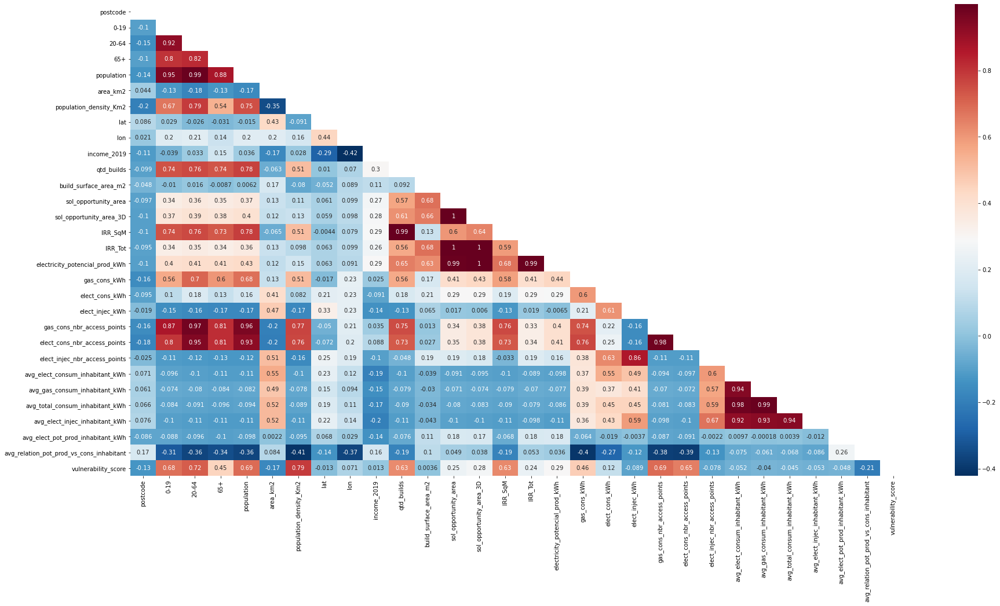

time: 2.55 s (started: 2023-06-21 11:13:35 +00:00)


In [62]:
# Correlation Matrix Calculation
correlation_matrix = df_sector_info_total[['sector_code',
       'postcode', '0-19', '20-64', '65+', 'population', 'area_km2',
       'population_density_Km2', 'lat', 'lon', 'CS01012022',
       'income_2019',
       'qtd_builds', 'build_surface_area_m2', 'sol_opportunity_area',
       'sol_opportunity_area_3D', 'IRR_SqM', 'IRR_Tot',
       'electricity_potencial_prod_kWh', 'gas_cons_kWh', 'elect_cons_kWh',
       'elect_injec_kWh', 'gas_cons_nbr_access_points',
       'elect_cons_nbr_access_points', 'elect_injec_nbr_access_points',
       'avg_elect_consum_inhabitant_kWh',
       'avg_gas_consum_inhabitant_kWh', 'avg_total_consum_inhabitant_kWh',
       'avg_elect_injec_inhabitant_kWh', 'avg_elect_pot_prod_inhabitant_kWh',
       'avg_relation_pot_prod_vs_cons_inhabitant',
       'vulnerability_score']].corr()

lower_triangle_mask = np.triu(np.ones(correlation_matrix.shape)).astype(np.bool)

# Lower Triangle of the Correlation matrix
correlation_matrix_lower = correlation_matrix.mask(lower_triangle_mask)

display(correlation_matrix_lower)

plt.figure(figsize = (30,15)) 

sns.heatmap(correlation_matrix_lower, 
            annot=True,    
            cmap='RdBu_r'); 

### Model

In [63]:
df_sector_info_total_model = df_sector_info_total[df_sector_info_total['population']!=0]

df_sector_info_total_model

,sector_WDL,T_SEC_DE,sector_external_source,sector_code,postcode,0-19,20-64,65+,population,area_km2,...,gas_cons_nbr_access_points,elect_cons_nbr_access_points,elect_injec_nbr_access_points,vulnerability_score,avg_elect_consum_inhabitant_kWh,avg_gas_consum_inhabitant_kWh,avg_total_consum_inhabitant_kWh,avg_elect_injec_inhabitant_kWh,avg_elect_pot_prod_inhabitant_kWh,avg_relation_pot_prod_vs_cons_inhabitant
0,Aaigem,AAIGEM,Aaigem,B354,9000,268,1029,273,1570,0.9415,...,564.619682,861.006118,1.500000,138.043465,5859.804537,16160.585135,22020.389672,3.344538,4927.237580,0.223758
1,N/A,ACHTENDRIES,Achtendries,E222,9000,342,913,239,1494,1.2380,...,513.000000,648.000000,0.000000,0.000000,2915.824444,7201.045428,10116.869873,0.000000,0.000000,0.000000
2,Afrikalaan,AFRIKALAAN,Afrikalaan,C710,9000,254,777,84,1115,0.6484,...,130.000000,645.875000,0.000000,231.273251,8034.868011,12775.957857,20810.825868,0.000000,10423.916592,0.500889
3,Afsnee - Centrum,AFSNEE-CENTRUM,Afsnee-Centrum,J200,9051,116,253,82,451,0.4456,...,127.674419,194.906977,0.000000,11.870613,2231.387403,7492.960933,9724.348336,0.000000,4527.498891,0.465584
4,Akademisch Ziekenhuis,AKADEMISCH ZIEKENHUIS,Akademisch Ziekenhuis,B422,9000,13,54,4,71,0.4828,...,49.118858,65.821540,0.121535,0.730011,12243.514150,14434.433727,26677.947876,15.044652,84386.830986,3.163168
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,Zonneput,ZONNEPUT,Zonneput,H091,9052,71,175,67,313,2.7610,...,97.887848,152.302802,0.000000,2.554438,2596.686116,5644.743431,8241.429547,0.000000,11581.348243,1.405260
197,Zuidpark,ZUIDPARK,Zuidpark,A23,9000,182,1358,445,1985,0.1804,...,735.658522,1656.310721,0.000000,1428.833416,2197.534764,8862.511785,11060.046549,0.000000,839.308816,0.075887
198,Zwarte Fles,ZWARTE FLES,Zwarte Fles,F091,9050,40,140,64,244,1.9400,...,84.691376,97.629003,0.000000,0.000000,1113.498588,5568.248090,6681.746678,0.000000,4388.913934,0.656851
199,Zwijnaarde - Centrum,ZWIJNAARDE-CENTRUM,Zwijnaarde-Centrum,H001,9052,612,1590,672,2874,0.9415,...,1060.913966,1366.651315,0.000000,626.676798,2748.378982,10967.739906,13716.118887,0.000000,3791.005915,0.276391


time: 25.4 ms (started: 2023-06-21 11:13:37 +00:00)


##### Normalizing features is a good practise when clustering, so we decided to do so on the features used except for latitude and longitude values, by keeping these in their original format, we hope that the clustering algorithm notices the difference in magnitude and finds these features influential
##### We chose 'avg_relation_pot_prod_vs_cons_inhabitant' and 'income_2019' as they produced tighter clusters, and these two metrics should be enough to identify areas with similar electricity needs and in similar socioeconomical situations (social factors)

In [64]:

features = [  'avg_relation_pot_prod_vs_cons_inhabitant', 'income_2019']#, 'sol_opportunity_area']
cluster_df = df_sector_info_total_model[['sector_WDL','lat','lon'] + features].dropna()
scaler = MinMaxScaler()
cluster_df[[f"{feat}_normalized" for feat in features]] = scaler.fit_transform(cluster_df[features])
cluster_df

,sector_WDL,lat,lon,avg_relation_pot_prod_vs_cons_inhabitant,income_2019,avg_relation_pot_prod_vs_cons_inhabitant_normalized,income_2019_normalized
0,Aaigem,51.033035,3.702773,0.223758,26573.0,0.056158,0.709313
1,N/A,51.076925,3.794294,0.000000,0.0,0.000000,0.000000
2,Afrikalaan,51.070435,3.737606,0.500889,12551.0,0.125711,0.335024
3,Afsnee - Centrum,51.033361,3.664934,0.465584,32092.0,0.116850,0.856632
4,Akademisch Ziekenhuis,51.024331,3.725873,3.163168,23023.0,0.793877,0.614553
...,...,...,...,...,...,...,...
196,Zonneput,50.988142,3.710763,1.405260,22594.0,0.352685,0.603102
197,Zuidpark,51.044649,3.732495,0.075887,23952.0,0.019046,0.639351
198,Zwarte Fles,51.042268,3.783924,0.656851,0.0,0.164853,0.000000
199,Zwijnaarde - Centrum,50.999664,3.712115,0.276391,22710.0,0.069367,0.606198


time: 24.8 ms (started: 2023-06-21 11:13:37 +00:00)


##### We experimented with Kmeans, DBSCAN and the OPTICS clustering algorithms, out of these, OPTICS provided the best results and the fact that we don't need to specify the number of clusters to be found is an added benefit as it makes the model more adaptable to new situations with similar data

In [65]:
opt = OPTICS()
opt.fit(cluster_df[['lat','lon'] + [f"{f}_normalized" for f in features]])
cluster_df['cluster'] = opt.labels_

time: 147 ms (started: 2023-06-21 11:13:38 +00:00)


##### Here we provide a visual representation of the clusters, points with the same colour belong to the same cluster. These groupings are useful as they help notice areas with identical needs and socioeconomic situation. Representing possible points of action.

In [66]:

# Coordinates for Ghent, Belgium
ghent_coordinates = [51.0543, 3.7174]
clr_map = {
    -1:'white',
    0:'green',
    1:'red',
    2:'yellow',
    3:'purple',
    4:'brown',
    5:'orange',
    6:'black',
    7:'gray',
    8:'lightblue',
    9:'darkgreen',
    10:'darkblue',
    11:'pink',
    12:'darkbrown'
    
}
# Create a Folium map centered on Ghent
ghent_map = folium.Map(location=ghent_coordinates, zoom_start=13)
data_points = []
for idx,row in cluster_df.iterrows():
    
    folium.CircleMarker(
        location=[row['lat'], row['lon']],
        color=clr_map[row['cluster']],
        fill=True,
        popup=f"""{row['sector_WDL']}\n
        avg_relation_pot_prod_vs_cons_inhabitant: {row['avg_relation_pot_prod_vs_cons_inhabitant']}\n
        income_2019: {row['income_2019']}\n
        """,
    ).add_to(ghent_map)


# Display the map
ghent_map.save('mainclusters.html')
ghent_map

time: 460 ms (started: 2023-06-21 11:13:38 +00:00)


## 🖼️ Visualisations

### Areas with higher and lower income per year and person

In [67]:
# Df will have a summary of each sector in terms of income, population, area lat, lng
df = df_sector_info_total[['sector_WDL','income_2019', 'population', 'area_km2','population_density_Km2','lat','lon']]
df.rename(columns={'income_2019': 'avg_income_2019', 'sector_WDL': 'sector'}, inplace=True)
df = df[(df['avg_income_2019']!=0) & ~(df['avg_income_2019'].isna())]

# Define max and min values for the field income
income_min_value = df['avg_income_2019'].min()
income_max_value = df['avg_income_2019'].max()

# Define max and min values for the field population
pop_min_value = df['population'].min()
pop_max_value = df['population'].max()

# Define the colormap
colormap = branca.colormap.LinearColormap(colors=['red', 'green'], index=[income_min_value, income_max_value])

# Compute the scale
scale_factor = 10 / (pop_max_value - pop_min_value)  # Ajuste o valor '10' conforme necessário para controlar o tamanho máximo dos círculos

# Create a centered Ghent map
mapa = folium.Map(location=[51.0638, 3.725], zoom_start=12, width=900, height=900)

# Iterate for each dataframe row
for _, row in df.iterrows():
    lat = row['lat']
    lon = row['lon']
    income = row['avg_income_2019']
    population = row['population']
    
    # size of the marker
    radius = (population - pop_min_value) * scale_factor
    
    # color of the marker
    cor = colormap(income)

    # define marker to add to the map 
    marker = folium.CircleMarker(location=[lat, lon], radius=radius, color=cor, fill=True).add_to(mapa)
        
    # Popup info
    popup_content = f"Sector: {row['sector']}<br>Sector Area: {row['area_km2']}km2<br>Avg Income 2019: {income}<br>Population 2022: {population}"
    popup_options = {'max_width': '200'}
    marker.add_child(folium.Popup(popup_content, **popup_options))

    # add marker to mapa
    marker.add_to(mapa)
    

# Legend
gradient_html = '''
    <div style="position: fixed;
                bottom: 50px; left: 50px; width: 200px; height: 40px;
                background: linear-gradient(to right, red, green);
                border: solid 1px #999999; z-index: 9999;
                ">
        <div style="text-align: center; padding: 5px;">
            <span style="font-weight: bold;">IncomePerYear_2019</span>
        </div>
        <div style="display: flex; justify-content: space-between; padding: 5px;">
            <span>{}</span>
            <span>{}</span>
        </div>
    </div>
'''.format(income_min_value, income_max_value)

# Add legend
mapa.get_root().html.add_child(folium.Element(gradient_html))
mapa.save("vizualizations/ghent_map_COLORincome_SIZEpopulation_by_sector.html")

mapa

time: 942 ms (started: 2023-06-21 11:13:38 +00:00)


#### With sector polygono

In [68]:
# Df will have a summary of each sector in terms of income, population, area lat, lng
df = df_sector_info_total[['sector_WDL','income_2019', 'population', 'area_km2','population_density_Km2','lat','lon','geometry']]
df.rename(columns={'income_2019': 'avg_income_2019', 'sector_WDL': 'sector'}, inplace=True)
df = df[(df['avg_income_2019']!=0) & ~(df['avg_income_2019'].isna())]


gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Create a centered Ghent map
mapa = folium.Map(location=[51.0638, 3.725], zoom_start=12, width=900, height=900)

# Define min and max for income 2019
income_min_value = df['avg_income_2019'].min()
income_max_value = df['avg_income_2019'].max()
income_range = income_max_value - income_min_value

# Define max of population
pop_max_value = df['population'].max()

# Def colormap
colormap = cm.LinearColormap(colors=['red', 'orange', 'green'], vmin=income_min_value, vmax=income_max_value)

def style_function(feature):
    income = feature['properties']['avg_income_2019']
    if income is None:
        income = 0
    population = feature['properties']['population']
    opacity = 0.2 + (population / pop_max_value)*0.8  
    color = colormap(income)
    
    return {
        'fillColor': color,
        'fillOpacity': opacity,
        'line_opacity': 0.2,
        'color': 'black',
        'weight': 0.3,
    }

# Add sector polygono
folium.GeoJson(
    gdf,
    name = 'Average Income and Population',
    style_function=lambda feature: style_function(feature),
    tooltip=folium.GeoJsonTooltip(fields=['sector','area_km2','population', 'avg_income_2019'], aliases=['Sector:','Area:', 'Population:', 'Avg Income 2019:'], localize=True),
).add_to(mapa)

# Add control layers
folium.LayerControl().add_to(mapa)

# Add legend
colormap.add_to(mapa)

# save to HTML
mapa.save("vizualizations/ghent_map_ColorIncome_OpacityPopulation.html")

mapa

time: 489 ms (started: 2023-06-21 11:13:39 +00:00)


### EnerGy Consumption by month in the last year

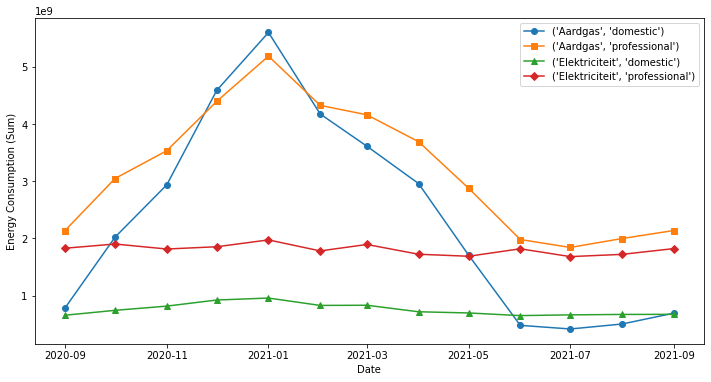

time: 212 ms (started: 2023-06-21 11:13:40 +00:00)


In [69]:
# Create a consumer profile
df = enr_consumer_profile(df=df_energy_consumption_monthly_t, col_slp='SLP')

# Create a pivot table with 'date' as index, 'energy' as columns and 'energy_consumption' as values
pivot_table = df.pivot_table(values='energy_consumption', index='date', columns=['energy','consumer_profile'], aggfunc='sum')

plt.figure(figsize=(12, 6))

# Set the desired markers for each combination of 'energy' and 'SLP'.
markers = ['o', 's', '^', 'D']

# plot graffic
for i, column in enumerate(pivot_table.columns):
    plt.plot(pivot_table.index, pivot_table[column], marker=markers[i%len(markers)])

# set labels and legend
plt.xlabel('Date')
plt.ylabel('Energy Consumption (Sum)')
plt.legend(pivot_table.columns)

plt.show()

### Energy Decentral and Local production

#### Decentral production

In [70]:
# filter the Gent municipality
df = df_energy_decentral_production[df_energy_decentral_production['postcode'].isin(df_sector_info_total['postcode'])]
df.head()

,year,type_technology,max_power_capacity_kVA,voltage_level_connection,municipality_code,postcode
9812,2017.0,Zonne-Energie (PV),3.30,LS,44019.0,9940.0
9813,2018.0,Zonne-Energie (PV),3.37,LS,44019.0,9940.0
9814,2017.0,Zonne-Energie (PV),5.00,LS,44019.0,9940.0
9815,2018.0,Zonne-Energie (PV),4.00,LS,44019.0,9940.0
9816,2016.0,Zonne-Energie (PV),4.40,LS,44019.0,9940.0


time: 23.9 ms (started: 2023-06-21 11:13:40 +00:00)


In [71]:
df.type_technology.unique()

array(['Zonne-Energie (PV)'], dtype=object)

time: 4.57 ms (started: 2023-06-21 11:13:40 +00:00)


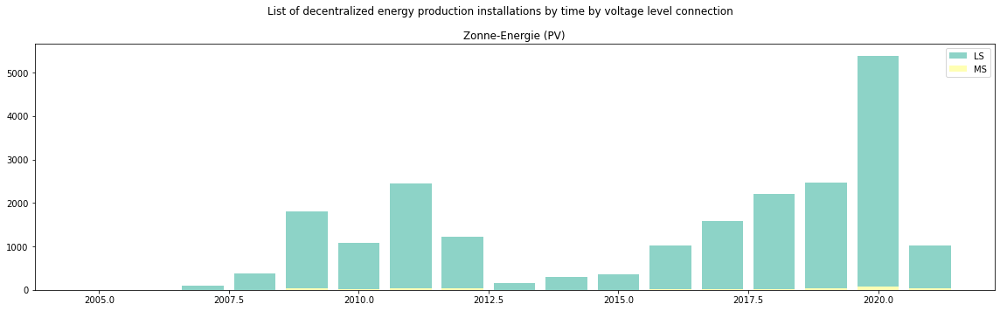

time: 284 ms (started: 2023-06-21 11:13:40 +00:00)


In [72]:
# group by 'year', 'type_technology', 'voltage_level_connection'
grouped = df.groupby(['year', 'type_technology', 'voltage_level_connection']).size().reset_index(name='count')

# valus for type of technology
technologies = df['type_technology'].unique()

# Bar Colors
volt_level_con_values = df['voltage_level_connection'].unique()
color_palette = sns.color_palette("Set3", len(volt_level_con_values))
color_mapping = dict(zip(volt_level_con_values, color_palette))

# Subplots
num_technologies = len(technologies)
fig, axes = plt.subplots(num_technologies, 1, sharex=True, figsize=(16, 5*num_technologies))


for i, technology in enumerate(technologies):
    ax = axes[i] if num_technologies > 1 else axes  
    
    data = grouped[grouped['type_technology'] == technology]
    
    added_labels = []
    
    for _, row in data.iterrows():
        volt_level_con_value = row['voltage_level_connection']
        count = row['count']
        
        if volt_level_con_value not in added_labels:
            color = color_mapping[volt_level_con_value]
            
            ax.bar(row['year'], count, color=color, label=volt_level_con_value)
            
            added_labels.append(volt_level_con_value)
        else:
            ax.bar(row['year'], count, color=color_mapping[volt_level_con_value])
    
    ax.set_title(technology)
    
    ax.legend()
    
fig.suptitle('List of decentralized energy production installations by time by voltage level connection')

plt.tight_layout()

plt.show()

#### Local production

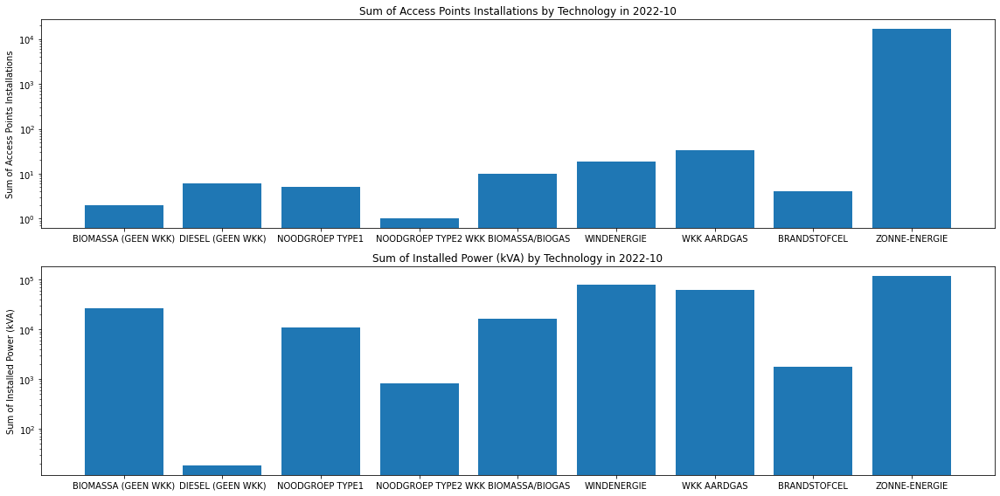

time: 916 ms (started: 2023-06-21 11:13:40 +00:00)


In [73]:
# filter the Gent municipality
df = df_energy_local_production[df_energy_local_production['municipality']=='GENT']
df.head()

# list of technologies
technologies = df['technology'].unique()

fig, axes = plt.subplots(2, 1, figsize=(16, 8))

ax1 = axes[0]
ax1.bar(technologies, df.groupby('technology')['access_points_installations'].sum())
ax1.set_ylabel('Sum of Access Points Installations')
ax1.set_title('Sum of Access Points Installations by Technology in 2022-10')
ax1.set_yscale('log')

ax2 = axes[1]
ax2.bar(technologies, df.groupby('technology')['installed_power_kVA'].sum())
ax2.set_ylabel('Sum of Installed Power (kVA)')
ax2.set_title('Sum of Installed Power (kVA) by Technology in 2022-10')
ax2.set_yscale('log')

plt.tight_layout()

plt.show()

### Some KPIs by sector

#### Consumption, production, income and population by sector (in the 30 most vulnerable sectors)

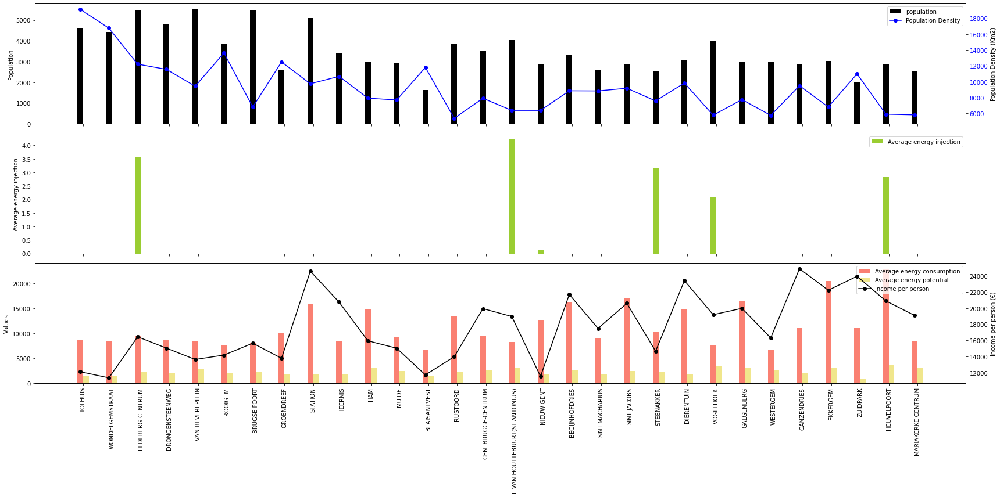

time: 1.16 s (started: 2023-06-21 11:13:41 +00:00)


In [74]:
import matplotlib.pyplot as plt
import numpy as np

# Sort the DataFrame by the values of 'vulnerability_score' in descending order and 'T_SEC_DE' in ascending order
df_sorted = df_sector_info_total.sort_values(by=['vulnerability_score', 'T_SEC_DE'], ascending=[False, True])
df_sorted = df_sorted.head(30)
df_sorted['average_income'] = df_sorted['income_2019']

# Conf bars
sectors = df_sorted['T_SEC_DE']
x = np.arange(len(sectors))
width = 0.2

# Colors
colors = ['#FA8072', '#9ACD32', '#F0E68C', '#FFFF00']

# fig (subplots)
fig, (ax0, ax1, ax2) = plt.subplots(3, 1, figsize=(24, 12), sharex=True)

# Population graffic
ax0.bar(x, df_sorted['population'], width, label='population', color='black')

# Axis conf
ax0.set_ylabel('Population')
ax0.tick_params(axis='y')


# Population density graffic
ax01 = ax0.twinx()
ax01.plot(x, df_sorted['population_density_Km2'], marker='o', color='blue', label='Population Density')

# Axis conf
ax01.set_ylabel('Population Density (Km2)')
ax01.tick_params(axis='y', labelcolor='blue')


ax2.bar(x, df_sorted['avg_total_consum_inhabitant_kWh'], width, label='Average energy consumption', color=colors[0])
ax2.bar(x + width, df_sorted['avg_elect_pot_prod_inhabitant_kWh'], width, label='Average energy potential', color=colors[2])

# Axis conf
ax2.set_ylabel('Values')

# Clone axis for 'average_income'
ax21 = ax2.twinx()
ax21.plot(x, df_sorted['average_income'], marker='o', color='black', label='Income per person')

# Axis conf
ax21.set_ylabel('Income per person (€)')
ax21.tick_params(axis='y', labelcolor='black')

# plot enery injection
ax1.bar(x, df_sorted['avg_elect_injec_inhabitant_kWh'], width, label='Average energy injection', color=colors[1])

# Axis configuration
ax1.set_ylabel('Average energy injection')
ax1.tick_params(axis='y')

# conf axis
ax2.set_xticks(x + 0.5 * width)
ax2.set_xticklabels(sectors, rotation=90)


# Add legend
lines0, labels0 = ax0.get_legend_handles_labels()
lines01, labels01 = ax01.get_legend_handles_labels()
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines21, labels21 = ax21.get_legend_handles_labels()
ax0.legend(lines0 + lines01, labels0 + labels01, loc='upper right')
ax1.legend(lines1 , labels1 , loc='upper right')
ax2.legend(lines2 + lines21, labels2 + labels21, loc='upper right')

fig.tight_layout()

# Exibir o gráfico
plt.show()

#### Energy Injection for top40 sectors that inject more energy

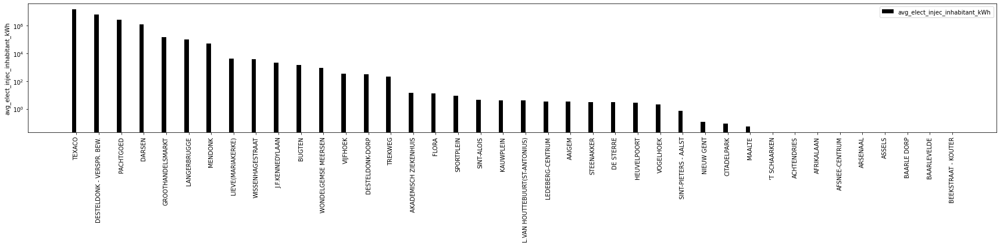

time: 559 ms (started: 2023-06-21 11:13:42 +00:00)


In [75]:
import matplotlib.pyplot as plt
import numpy as np

# Sort the DataFrame by the values of 'avg_elect_injec_inhabitant_kWh' in descending order and 'T_SEC_DE' in ascending order
df_sorted_inj = df_sector_info_total.sort_values(by=['avg_elect_injec_inhabitant_kWh', 'T_SEC_DE'], ascending=[False, True])
df_sorted_inj = df_sorted_inj.head(40)

# Conf Bars
sectors = df_sorted_inj['T_SEC_DE']
x = np.arange(len(sectors))
width = 0.2

# chose colors
colors = ['#FA8072', '#9ACD32', '#F0E68C', '#FFFF00']

# create grid 
fig, (ax0) = plt.subplots(1, 1, figsize=(24, 6), sharex=True)

# plot
ax0.bar(x, df_sorted_inj['avg_elect_injec_inhabitant_kWh'], width, label='avg_elect_injec_inhabitant_kWh', color='black')

# Axis in log
ax0.set_yscale('log')

# Conf axis
ax0.set_ylabel('avg_elect_injec_inhabitant_kWh')
ax0.tick_params(axis='y')

# conf axis shared
ax0.set_xticks(x + 0.5 * width)
ax0.set_xticklabels(sectors, rotation=90)

# Add legend
lines0, labels0 = ax0.get_legend_handles_labels()
ax0.legend(lines0, labels0, loc='upper right')

fig.tight_layout()

plt.show()

### Areas with higher and lower energy consumption, and potencial production

* 'vulnerability_score' - score to evaluate the vulnerability of the population that lives in the sector
    * 'avg_elect_consum_inhabitant_kWh' - average electricity consumption per inhabitant in kWh, in 2021, in the sector
    * 'avg_gas_consum_inhabitant_kWh'- average gas consumption per inhabitant in kWh, in 2021, in the sector
    * 'avg_total_consum_inhabitant_kWh' - average total energy (gas+electricity) consumption per inhabitant in kWh, in 2021, in the sector
    * 'avg_elect_injec_inhabitant_kWh' - average electricity injection per inhabitant in kWh, in 2021, in the sector
    * 'avg_elect_pot_prod_inhabitant_kWh' - average potencial electricity production per inhabitant in kWh for the sector 
    * 'avg_relation_pot_prod_vs_cons_inhabitant' - relation between the average of potencial electricity production and total energy consumption per inhabitant of the sector

In [77]:
# Df will have a summary of each sector in terms of income, population, area lat, lon
df = df_sector_info_total[['T_SEC_DE','income_2019', 'population', 'area_km2','population_density_Km2', 'qtd_builds'
                           ,'lat','lon','geometry','gas_cons_kWh', 'elect_cons_kWh', 'elect_injec_kWh'
                           ,'sol_opportunity_area','electricity_potencial_prod_kWh'
                           ,'avg_total_consum_inhabitant_kWh','avg_elect_pot_prod_inhabitant_kWh', 'avg_relation_pot_prod_vs_cons_inhabitant']]

df.rename(columns={'income_2019': 'avg_income_2019', 'T_SEC_DE': 'sector'}, inplace=True)

min_population_limit = 0
max_population_limit = 30000


# Convert DataFrame in GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Create a centered Ghent map
mapa = folium.Map(location=[51.0638, 3.725], zoom_start=12, width=900, height=900)



####################################################################################

# Define min and max values of income_2019
income_min_value = df[df['avg_income_2019']!=0]['avg_income_2019'].min()
income_max_value = df['avg_income_2019'].max()
income_range = income_max_value - income_min_value

pop_max_value = df['population'].max()

# Define colormaps
colormap = cm.LinearColormap(colors=['red', 'orange', 'green'], vmin=income_min_value, vmax=income_max_value)

# Def polygon style
def polygon_style_function(feature):
    
    income = feature['properties']['avg_income_2019']
    population = feature['properties']['population']
    
    if not(income == 0 or income is None):
        opacity = 0.2 + (population / pop_max_value) * 0.8  
        color = colormap(income)
    else:
        opacity = 0
        color = 'black'

    return {
        'fillColor': color,
        'fillOpacity': opacity,
        'line_opacity': 0.2,
        'color': 'black',
        'weight': 0.3,
    }


# add polygon with the above style
folium.GeoJson(
    gdf,
    name='Average Income and Population',
    style_function=lambda feature: polygon_style_function(feature),
    tooltip=folium.GeoJsonTooltip(fields=['sector', 'area_km2', 'population', 'population_density_Km2','qtd_builds','avg_income_2019'
                                          ,'gas_cons_kWh', 'elect_cons_kWh', 'elect_injec_kWh'
                                          ,'sol_opportunity_area','electricity_potencial_prod_kWh' ],
                                  aliases=['Sector:', 'Area:', 'Population:', 'Population Density (Km2):','Quantity of Buildings:', 'Avg Income 2019:'
                                          ,'Gas Consumption (kWh):', 'Electricity Consumption (kWh):', 'Electricity Injection (kWh):'
                                          ,'Sol Opportunity Area (m2):', 'Electricity Potencial Production (kWh):'],
                                  localize=True),
).add_to(mapa)


####################################################################################

# new layer for energy consumption
marker_layer = folium.FeatureGroup(name='Energy Consumption')

# Define min and max for 'elect_cons_kWh'
consumption_min_value = df[(df['population'] >= min_population_limit) & (df['population'] <= max_population_limit)]['avg_total_consum_inhabitant_kWh'].min()
consumption_max_value = df[(df['population'] >= min_population_limit) & (df['population'] <= max_population_limit)]['avg_total_consum_inhabitant_kWh'].max()
consumption_range = consumption_max_value - consumption_min_value

# Define color
color_marker = '#ED5151'

# Iterate in  GeoDataFrame
for index, row in gdf.iterrows():
    if min_population_limit <= row['population'] <= max_population_limit:
        lat = row['lat']
        lon = row['lon']

        consumption = row['avg_total_consum_inhabitant_kWh']
        if np.isnan(consumption):
            consumption = 0

        # marker sizedefinition
        if consumption == 0:
            marker_radius = 0
        else:
            marker_radius = 5 + ((consumption - consumption_min_value) / consumption_range) * 10

        # crate a marker
        marker = folium.CircleMarker(
            location=[lat, lon],
            radius=marker_radius,
            color='black',
            fill=color_marker,
            fill_color=color_marker,
            fill_opacity=0.7,
            weight=0.2
        )

        # Add marker to layer
        marker.add_to(marker_layer)

# Add layer to map
marker_layer.add_to(mapa)

####################################################################################

# # new layer for  electricity_potencial_prod_kWh
pot_elect_prod_layer = folium.FeatureGroup(name='Electricity Potential Production')

# Define min and max of 'electricity_potencial_prod_kWh'
electricity_min_value = df[(df['population'] >= min_population_limit) & (df['population'] <= max_population_limit)]['avg_elect_pot_prod_inhabitant_kWh'].min()
electricity_max_value = df[(df['population'] >= min_population_limit) & (df['population'] <= max_population_limit)]['avg_elect_pot_prod_inhabitant_kWh'].max()
electricity_range = electricity_max_value - electricity_min_value

color_marker_trig = '#FFEC99'
color_marker_trig = '#3182BD'

# iterate of each setores of GeoDataFrame
for index, row in gdf.iterrows():
    if min_population_limit <= row['population'] <= max_population_limit:
        lat = row['lat']+0.001
        lon = row['lon']

        electricity_potential = row['avg_elect_pot_prod_inhabitant_kWh']

        # marker size
        if electricity_potential == 0:
            marker_radius = 0
        else:
            marker_radius = 5 + ((electricity_potential - electricity_min_value) / electricity_range) * 10

        # marker creation
        marker = folium.CircleMarker(
            location=[lat, lon],
            radius=marker_radius,
            color='black',
            fill=color_marker_trig,
            fill_color=color_marker_trig,
            fill_opacity=0.7,
            weight=0.2
        )

        # add marker to the layer
        marker.add_to(pot_elect_prod_layer)

# add layer to map
pot_elect_prod_layer.add_to(mapa)    
    
    
####################################################################################


# Creation of layer for electricity_potencial_prod_kWh
pot_vs_cons_elect_layer = folium.FeatureGroup(name='Electricity Potential Production VS Consumption')

# Define min and max of 'electricity_potencial_prod_kWh'
pot_vs_cons_elect_min_value = df[(df['population'] >= min_population_limit) & (df['population'] <= max_population_limit)]['avg_relation_pot_prod_vs_cons_inhabitant'].min()
pot_vs_cons_elect_max_value = df[(df['population'] >= min_population_limit) & (df['population'] <= max_population_limit)]['avg_relation_pot_prod_vs_cons_inhabitant'].max()
pot_vs_cons_elect_range = pot_vs_cons_elect_max_value - pot_vs_cons_elect_min_value

color_marker_trig = 'black'

# Iteration for each sector in GeoDataFrame
for index, row in gdf.iterrows():
    if min_population_limit <= row['population'] <= max_population_limit:
        lat = row['lat']
        lon = row['lon']

        pot_vs_cons_elect_potential = row['avg_relation_pot_prod_vs_cons_inhabitant']

        # Marker size
        if pot_vs_cons_elect_potential == 0:
            marker_radius = 0
        else:
            marker_radius = 5 + ((pot_vs_cons_elect_potential - pot_vs_cons_elect_min_value) / pot_vs_cons_elect_range) * 10

        # creation of marker
        marker = folium.CircleMarker(
            location=[lat, lon],
            radius=marker_radius,
            color='black',
            fill=color_marker_trig,
            fill_color=color_marker_trig,
            fill_opacity=0.4,
            weight=0.2
        )

        # add market to layer
        marker.add_to(pot_vs_cons_elect_layer)

# Add layer to map
pot_vs_cons_elect_layer.add_to(mapa)    
    
####################################################################################

# add layer control panel
folium.LayerControl().add_to(mapa)
# maps legend
colormap.add_to(mapa)

marker_layer.add_to(mapa)
energy_legend = 'Energy Consuption kWh'

# Adicionar uma legenda adicional aos marcadores
mapa.get_root().html.add_child(folium.Element(energy_legend))

# Salvar o mapa em um arquivo HTML
mapa.save("vizualizations/ghent_map_ColorIncome_EnergyConsProduction_Markers.html")

# Exibir o mapa
mapa

time: 1.48 s (started: 2023-06-21 11:13:44 +00:00)


## 👓 References
List all of the external links (even if they are already linked above), such as external datasets, papers, blog posts, code repositories and any other materials.

External datasources:
* [1] https://stad.gent/sites/default/files/media/documents/51725-1679308738-Bevolkingsrapport%20Gent%202022-1973fe.pdf
    * To obtain the population by sector of Ghent. We use the info present in the pages 101 - 105
    * We only extract the Totaal values by gae range: 0-19, 20-64, 65+
    
* [2] https://www.citypopulation.de/en/belgium/agglogent/admin/44021__gent/
    * To obtain the location of each sector - Not directily from this site, but using the vizualization to help us to obtain a coordinate for each sector
    * To obtain the area in Km2 for each sector
    * We also use this site to obtain the estimated population for the sectors not present in the source identified above. It only apends when the population is 0 or at most 8. In these cases, when tere is at least 1 person, whe considered that he is inside the age range of 20-64
    
Portal - a small frontend created by us
* [3] https://peaceful-sherbet-485f81.netlify.app/dashboard-two
    * First page with some heatmaps of Ghent city for income, consumption, energy potencial and the result of our clustering model

* [4] https://peaceful-sherbet-485f81.netlify.app/pricing 
    * Second page, an environmental calculator. This calculator quantifies the positive impact of solar panels installation in the environment for a range of outputs, such as carbon dioxid reduction, passenger car taken out of road. etc